In [1]:
# import combined_financial_data as df
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

data = pd.read_csv('combined_financial_data.csv')

/Users/alex/anaconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (


In [3]:
# Define the industry classification for the stocks
industry_classification = {
    'AAPL': 'Technology', 'CRM': 'Technology', 'CSCO': 'Technology', 'IBM': 'Technology', 
    'INTC': 'Technology', 'MSFT': 'Technology', 'TSLA': 'Technology', 
    'AMGN': 'Healthcare', 'JNJ': 'Healthcare', 'MRK': 'Healthcare', 'UNH': 'Healthcare', 
    'AXP': 'Financial Services', 'GS': 'Financial Services', 'JPM': 'Financial Services', 
    'TRV': 'Financial Services', 'Visa': 'Financial Services', 
    'KO': 'Consumer Goods', 'MCD': 'Consumer Goods', 'NKE': 'Consumer Goods', 'WMT': 'Consumer Goods', 
    'BA': 'Industrial', 'CAT': 'Industrial', 'HD': 'Industrial', 'HON': 'Industrial', 'MMM': 'Industrial', 
    'CVX': 'Energy', 
    'VZ': 'Telecommunications', 
    'DIS': 'Entertainment'
}

# Map the stock symbols to their respective industries
data['Industry'] = data['ticker'].map(industry_classification)

# Verify the mapping by displaying the first few rows of the dataset with the new Industry column
data.head()

,Unnamed: 0,date,permno,ticker,price,volume,return,high,low,open,avg_price,mkt_cap,pct_return,ticker_attention,name_price_attention,Industry
0,0,2014-01-02,10107,MSFT,37.16,30423757.0,-0.006683,37.40,37.10,37.350,37.25,308428000.0,-0.6683,3.25,3.15,Technology
1,1,2014-01-03,10107,MSFT,36.91,30944370.0,-0.006728,37.22,36.60,37.200,36.91,306353000.0,-0.6728,3.38,1.54,Technology
2,2,2014-01-06,10107,MSFT,36.13,43111355.0,-0.021133,36.89,36.11,36.850,36.50,299879000.0,-2.1133,4.03,2.24,Technology
3,3,2014-01-07,10107,MSFT,36.41,35478667.0,0.007750,36.49,36.21,36.325,36.35,302203000.0,0.7750,4.94,1.19,Technology
4,4,2014-01-08,10107,MSFT,35.76,59452427.0,-0.017852,36.14,35.58,36.000,35.86,296808000.0,-1.7852,5.33,1.68,Technology


Data Exploration and visual analysis 

In [5]:
# Reload the dataset and display summary statistics
#data = pd.read_csv('/mnt/data/combined_financial_data.csv')

# Convert 'Date' to datetime format
data['date'] = pd.to_datetime(data['date'])

# Summary statistics for numerical columns
summary_statistics = data.describe()

# Display summary statistics
summary_statistics


,Unnamed: 0,date,permno,price,volume,return,high,low,open,avg_price,mkt_cap,pct_return,ticker_attention,name_price_attention
count,64008.000000,64008,64008.000000,64008.000000,6.400800e+04,64008.000000,64008.000000,64008.000000,64008.000000,64008.000000,6.400800e+04,64008.000000,64008.000000,64008.000000
mean,32003.500000,2018-07-17 02:38:06.614173440,42556.107143,141.842652,1.120197e+07,0.000611,143.349911,140.268670,141.827757,141.809290,2.433321e+08,0.061122,34.653278,13.846686
min,0.000000,2014-01-02 00:00:00,10107.000000,21.349900,3.053580e+05,-0.238484,21.620000,21.270000,21.340000,21.445000,1.715150e+07,-23.848400,0.000000,0.000000
25%,16001.750000,2016-04-11 00:00:00,17270.500000,78.880000,3.362626e+06,-0.006755,79.460000,78.197525,78.867500,78.853125,1.030126e+08,-0.675525,19.500000,0.000000
50%,32003.500000,2018-07-17 12:00:00,34926.000000,122.145000,6.226876e+06,0.000613,123.270350,120.970000,122.100000,122.153750,1.667941e+08,0.061300,32.550000,9.250000
75%,48005.250000,2020-10-22 00:00:00,61063.000000,171.789990,1.288676e+07,0.008166,173.360000,169.912500,171.720000,171.664623,2.399616e+08,0.816600,49.020000,21.330000
max,64007.000000,2023-01-31 00:00:00,93436.000000,2238.750000,6.182376e+08,0.260449,2318.489990,2186.520020,2295.120120,2252.505005,2.974939e+09,26.044900,100.000000,100.000000
std,18477.662352,NaN,28269.184013,108.306863,1.535519e+07,0.017623,110.429189,106.063573,108.266776,108.228460,3.261015e+08,1.762306,18.905529,15.384599


Stock Prices (PX_LAST, PX_OPEN, PX_HIGH, PX_LOW): The stock prices vary significantly across the dataset, with a mean price around 106.87 and a wide range from 2.19 to 545.24, reflecting the diversity of stock prices included.

Volatility: On average, the daily volatility is 2.14, with a standard deviation of 2.56, indicating variability in daily price movements across stocks.

Change and % Change: The mean change in stock prices is close to zero, but with a standard deviation indicating considerable day-to-day price movement. Percentage change also shows a similar pattern, highlighting the variability in daily stock price changes.

Investor Attention (ticker_attention, name_price_attention): The average levels of investor attention (measured by scaled Google Trends search queries) vary, with a mean of 34.34 for ticker_attention and 14.11 for name_price_attention. The wide range (0 to 100) for both indicates periods of low and high investor interest.

Next, let's proceed with the visual analysis, starting with time series plots of stock prices and investor attention metrics to identify trends and potential correlations visually:

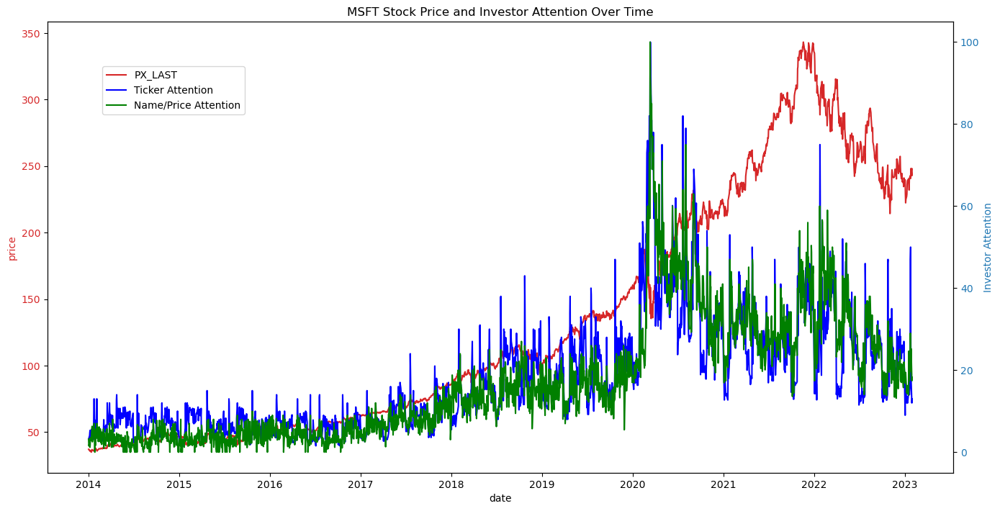

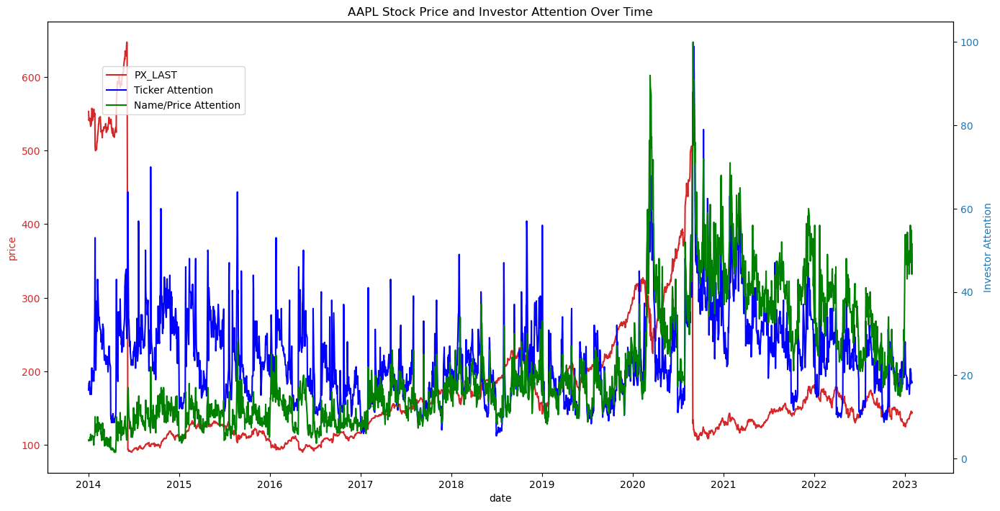

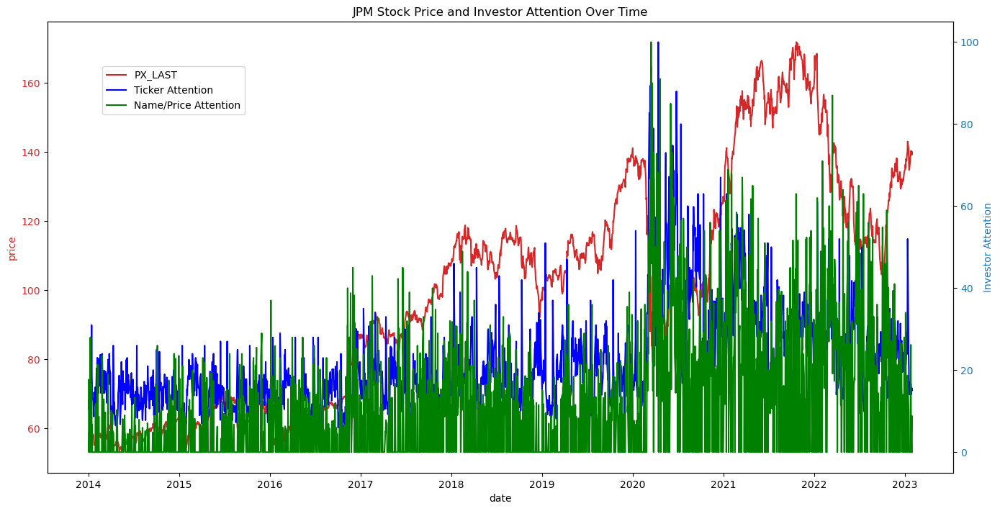

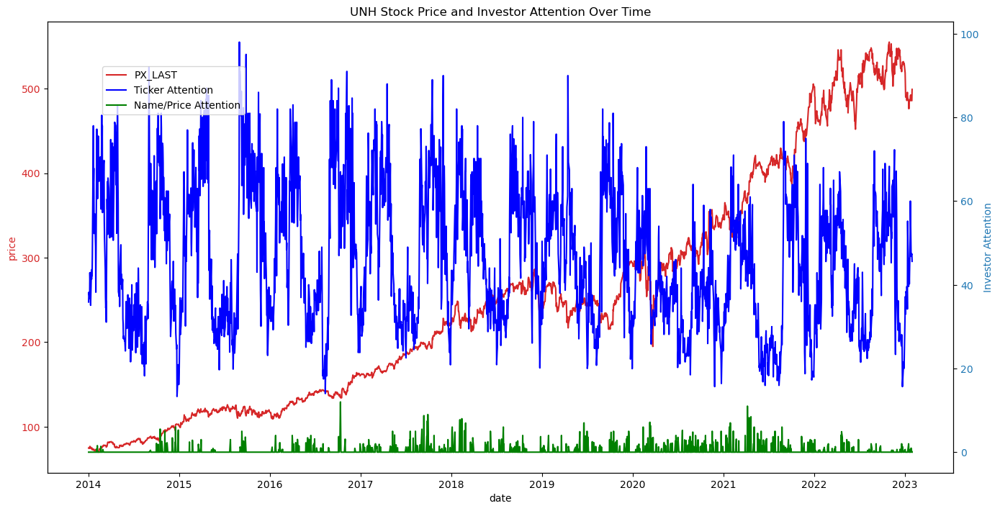

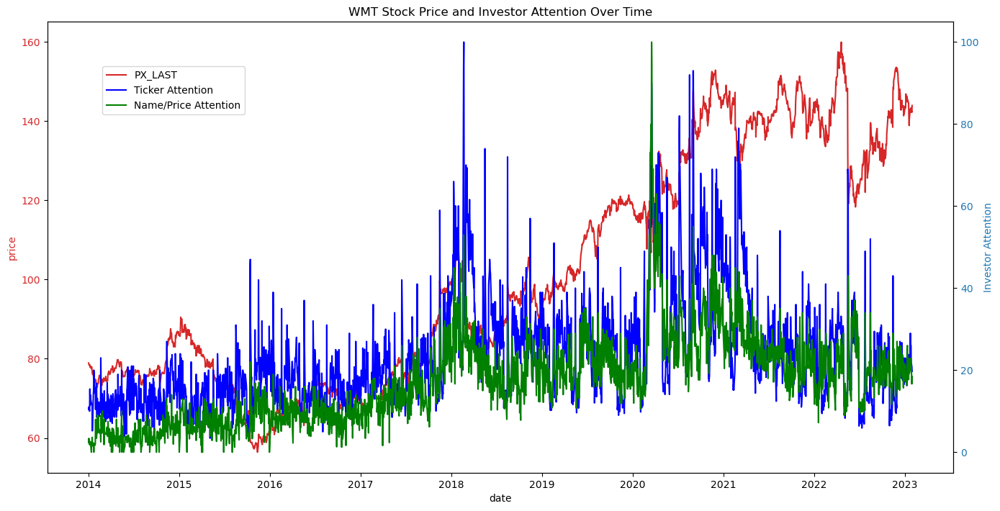

...

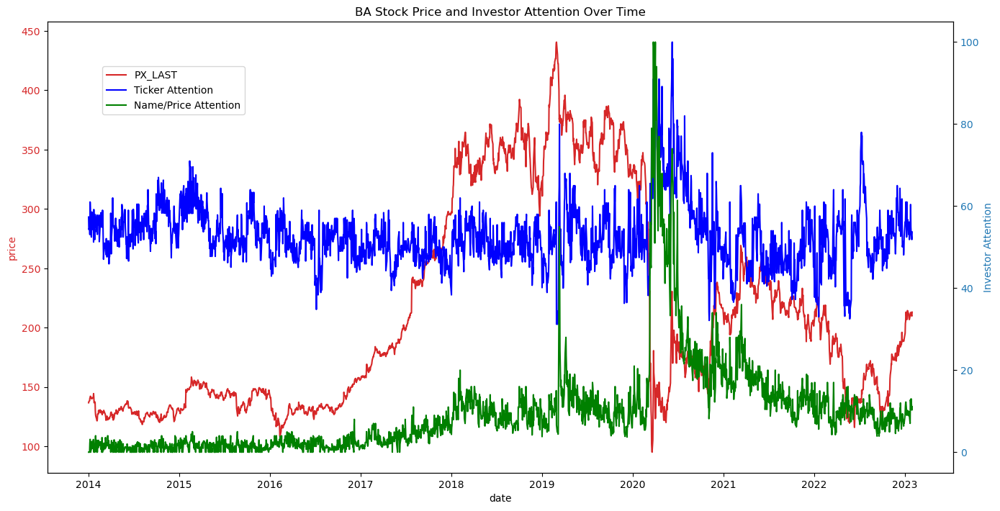

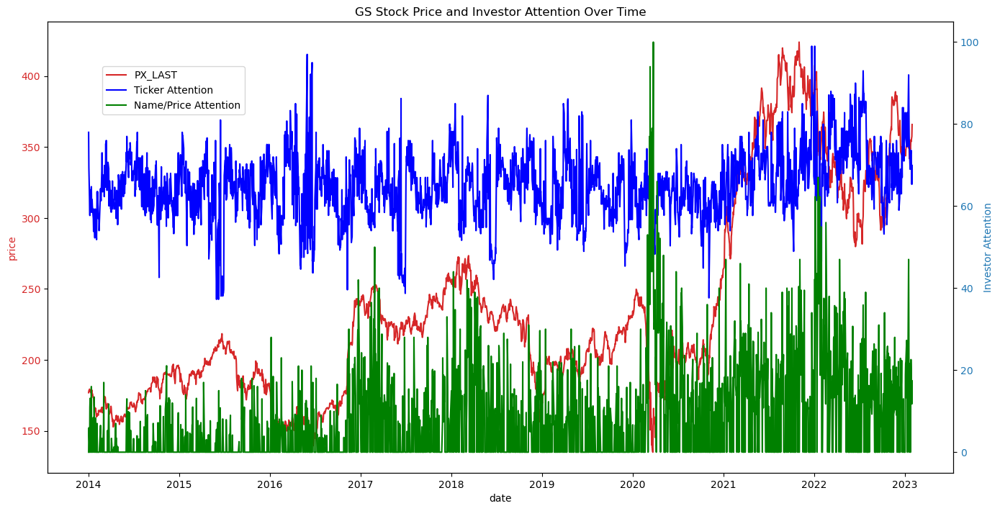

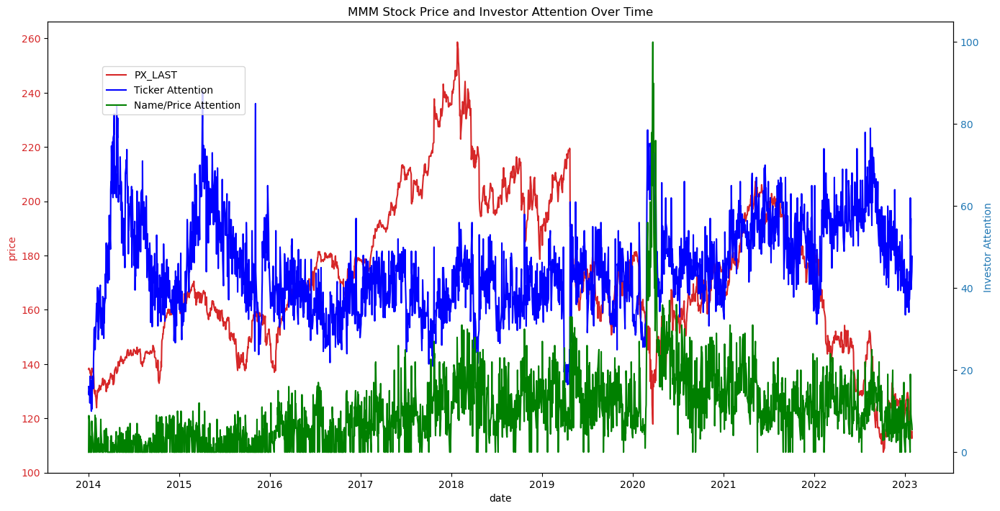

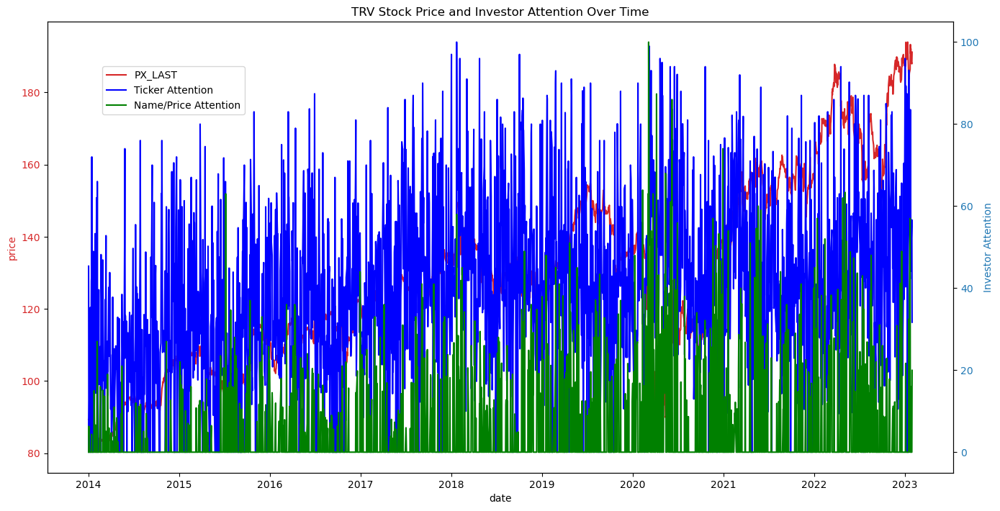

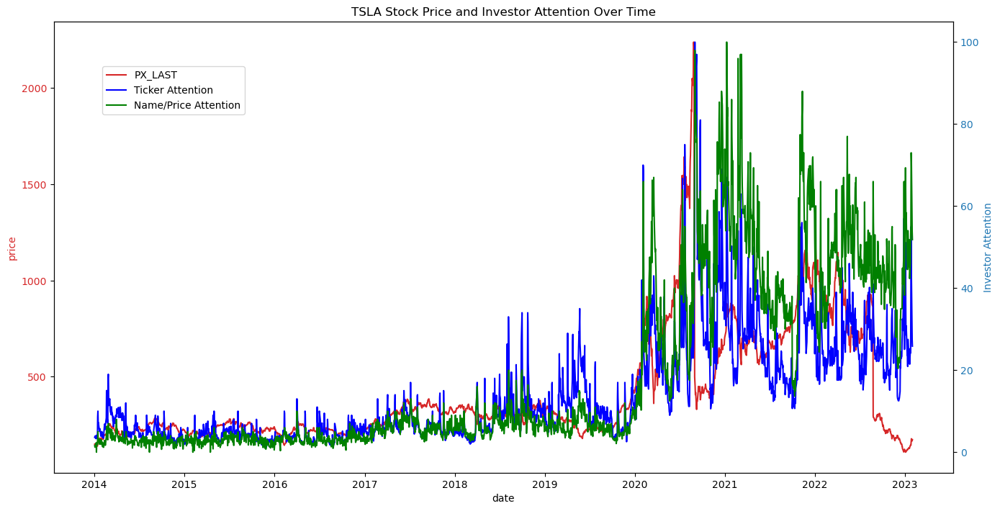

In [8]:
# write a loop that will plot the stock price and investor attention for all stocks in the dataset
stocks = data['ticker'].unique()

for stock in stocks:
    stock_data = data[data['ticker'] == stock]
    fig, ax1 = plt.subplots(figsize=(14, 7))

    color = 'tab:red'
    ax1.set_xlabel('date')
    ax1.set_ylabel('price', color=color)
    ax1.plot(stock_data['date'], stock_data['price'], color=color, label='PX_LAST')
    ax1.tick_params(axis='y', labelcolor=color)

    ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
    color = 'tab:blue'
    ax2.set_ylabel('Investor Attention', color=color)  # we already handled the x-label with ax1
    ax2.plot(stock_data['date'], stock_data['ticker_attention'], color='blue', label='Ticker Attention')
    ax2.plot(stock_data['date'], stock_data['name_price_attention'], color='green', label='Name/Price Attention')
    ax2.tick_params(axis='y', labelcolor=color)

    fig.tight_layout()  # otherwise the right y-label is slightly clipped
    plt.title(f'{stock} Stock Price and Investor Attention Over Time')
    fig.legend(loc="upper left", bbox_to_anchor=(0.1,0.9))
    plt.show()

To visually examine the relationship between the dependent variable (daily percentage change in stock prices, % Change) and the independent variables (investor attention metrics, ticker_attention and name_price_attention), scatter plots are an effective tool. These plots can help us assess whether the relationship appears linear, which would justify the use of linear regression, or if the data suggests a non-linear relationship, indicating the potential need for a different type of regression model.

In [9]:
# add a column that shows the % change of the Ticker Attention and Name/Price Attention from the previous day
data['ticker_attention_%_change'] = data['ticker_attention'].pct_change()
data['name_price_attention_%_change'] = data['name_price_attention'].pct_change()

data['transformed_price'] = np.log(data['price'])
data['transformed_ticker_attention'] = np.log(data['ticker_attention'])

# Display the first few rows of the dataset with the new columns
data.head()


/Users/alex/anaconda3/lib/python3.11/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


,Unnamed: 0,date,permno,ticker,price,volume,return,high,low,open,avg_price,mkt_cap,pct_return,ticker_attention,name_price_attention,Industry,ticker_attention_%_change,name_price_attention_%_change,transformed_price,transformed_ticker_attention
0,0,2014-01-02,10107,MSFT,37.16,30423757.0,-0.006683,37.40,37.10,37.350,37.25,308428000.0,-0.6683,3.25,3.15,Technology,NaN,NaN,3.615233,1.178655
1,1,2014-01-03,10107,MSFT,36.91,30944370.0,-0.006728,37.22,36.60,37.200,36.91,306353000.0,-0.6728,3.38,1.54,Technology,0.040000,-0.511111,3.608483,1.217876
2,2,2014-01-06,10107,MSFT,36.13,43111355.0,-0.021133,36.89,36.11,36.850,36.50,299879000.0,-2.1133,4.03,2.24,Technology,0.192308,0.454545,3.587124,1.393766
3,3,2014-01-07,10107,MSFT,36.41,35478667.0,0.007750,36.49,36.21,36.325,36.35,302203000.0,0.7750,4.94,1.19,Technology,0.225806,-0.468750,3.594843,1.597365
4,4,2014-01-08,10107,MSFT,35.76,59452427.0,-0.017852,36.14,35.58,36.000,35.86,296808000.0,-1.7852,5.33,1.68,Technology,0.078947,0.411765,3.576830,1.673351


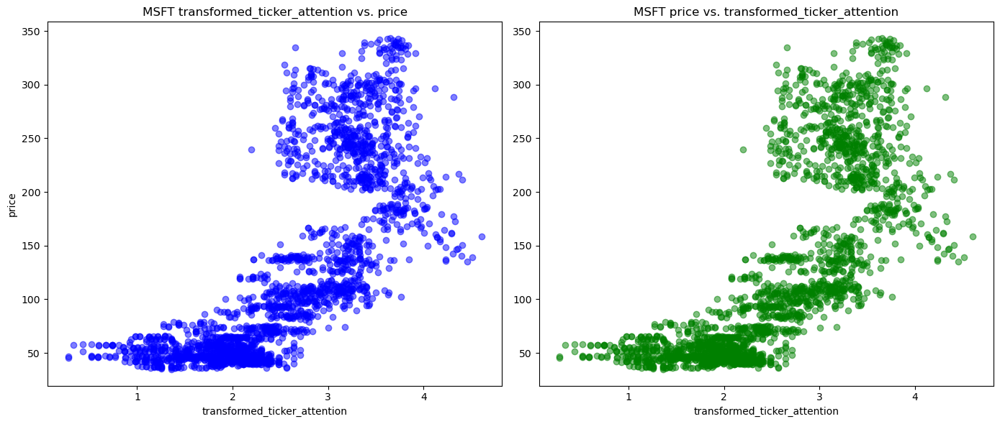

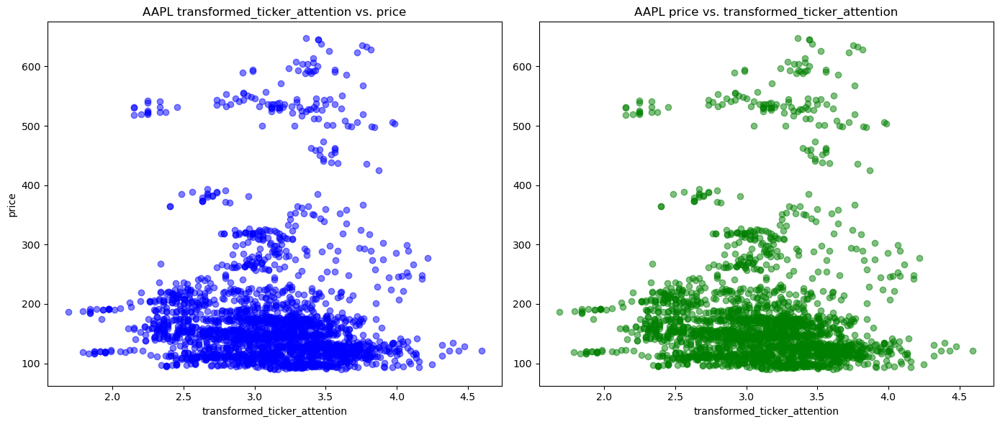

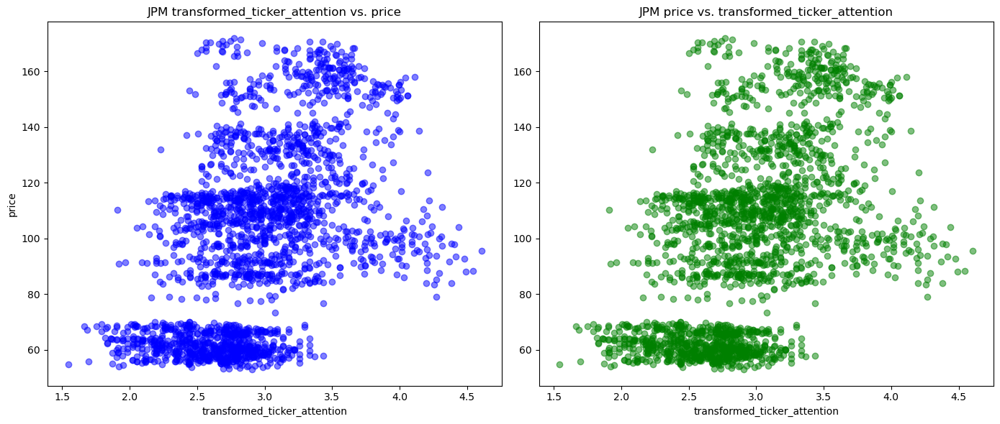

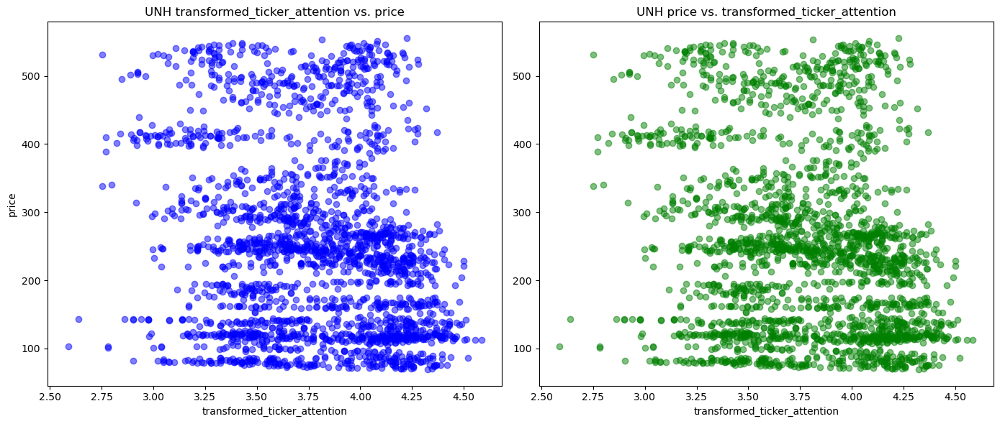

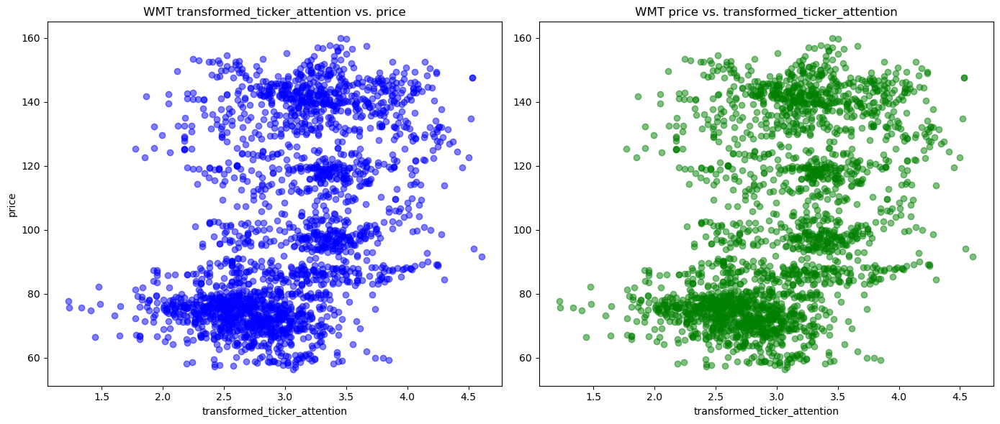

...

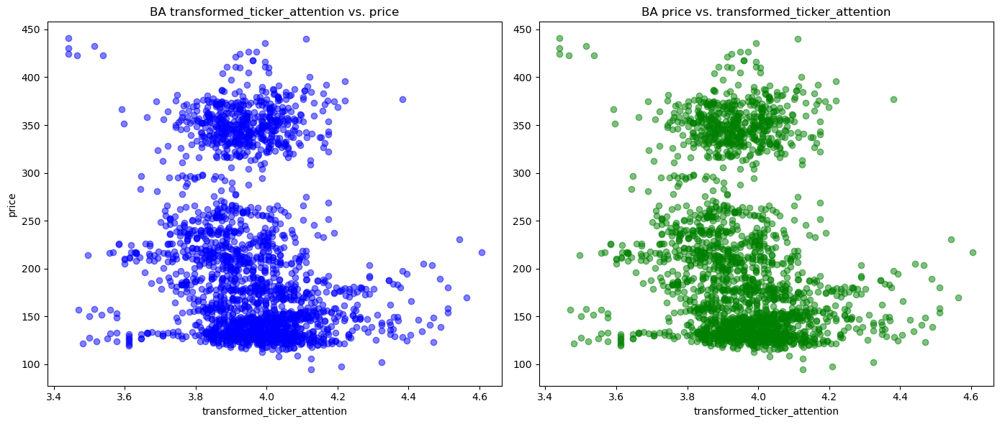

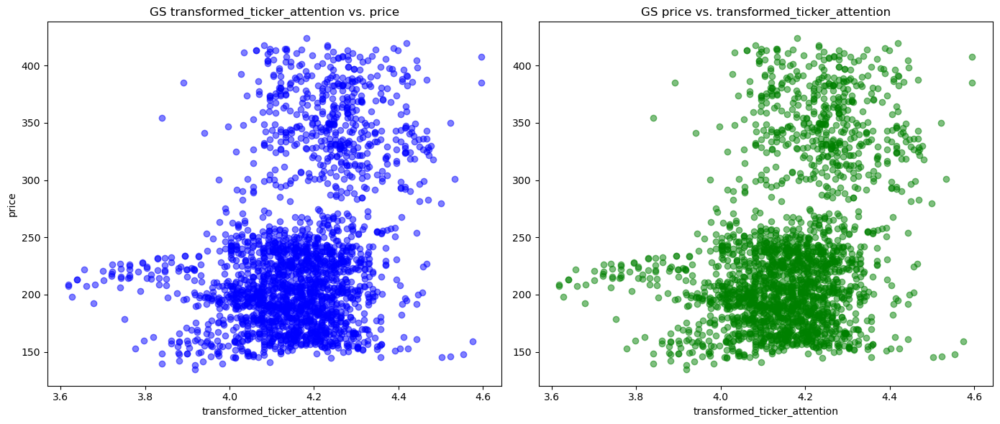

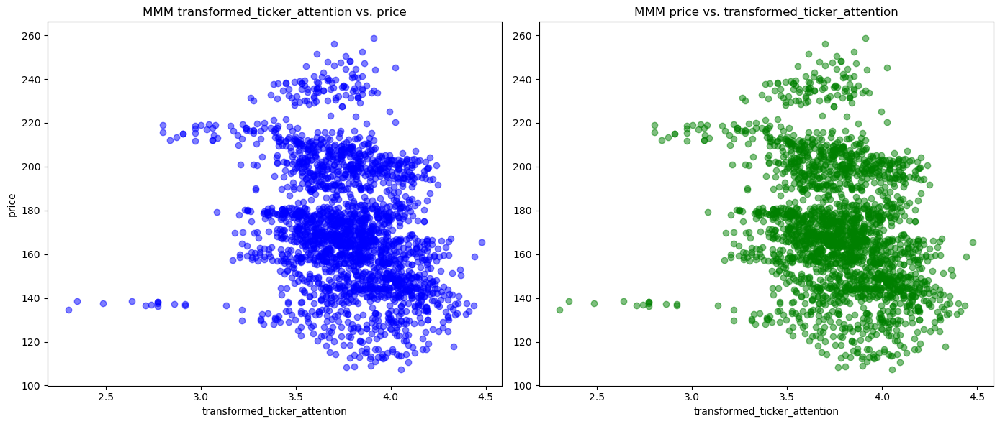

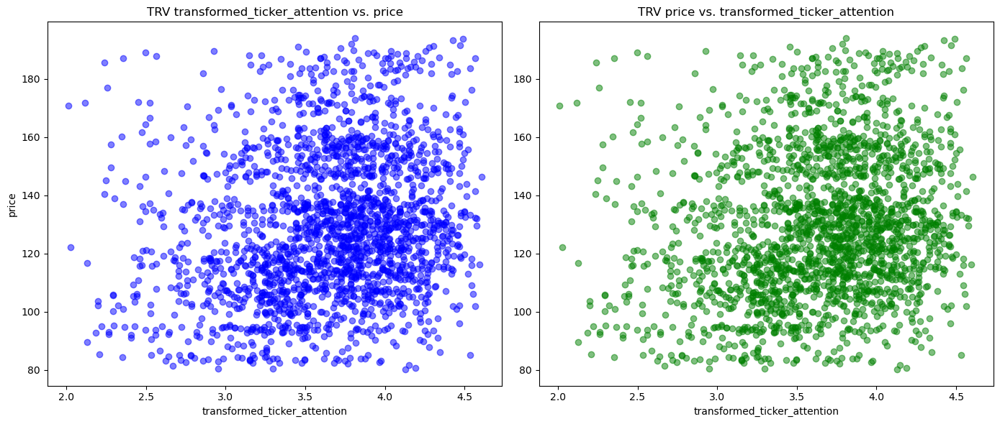

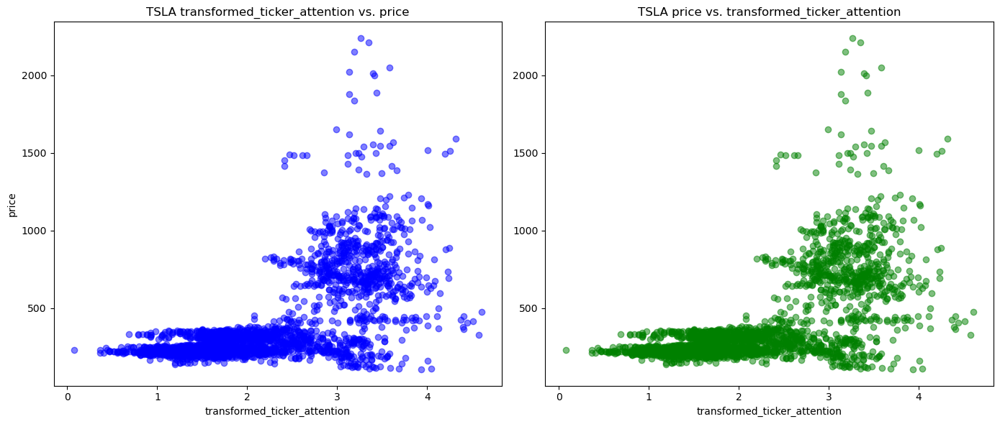

In [11]:
# create a scatterplot displaying the relationship between % change of price and % change of Ticker Attention and Name/Price Attention
for stock in stocks:
    stock_data = data[data['ticker'] == stock]
    fig, axs = plt.subplots(1, 2, figsize=(14, 6))

    # Scatter plot for % Change vs. Ticker Attention
    axs[0].scatter(stock_data['transformed_ticker_attention'], stock_data['price'], color='blue', alpha=0.5)
    axs[0].set_title(f'{stock} transformed_ticker_attention vs. price')
    axs[0].set_xlabel('transformed_ticker_attention')
    axs[0].set_ylabel('price')

    # Scatter plot for % Change vs. Name/Price Attention
    axs[1].scatter(stock_data['transformed_ticker_attention'], stock_data['price'], color='green', alpha=0.5)
    axs[1].set_title(f'{stock} price vs. transformed_ticker_attention')
    axs[1].set_xlabel('transformed_ticker_attention')

    plt.tight_layout()
    plt.show()

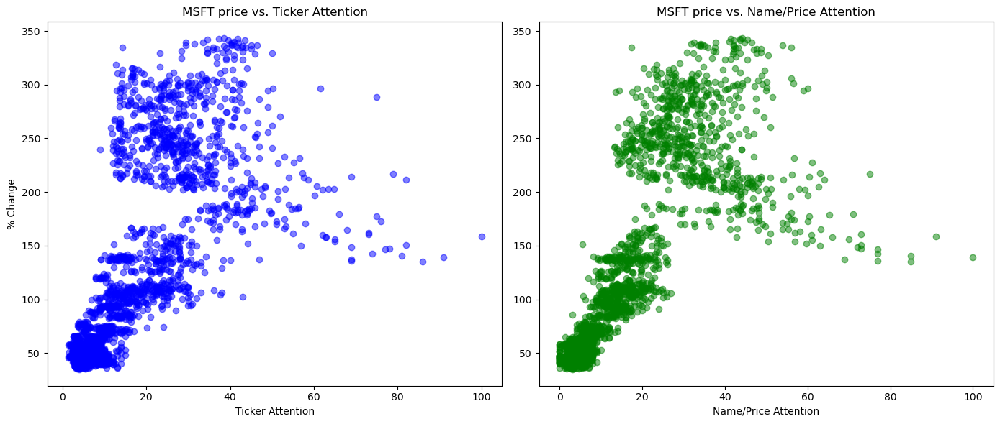

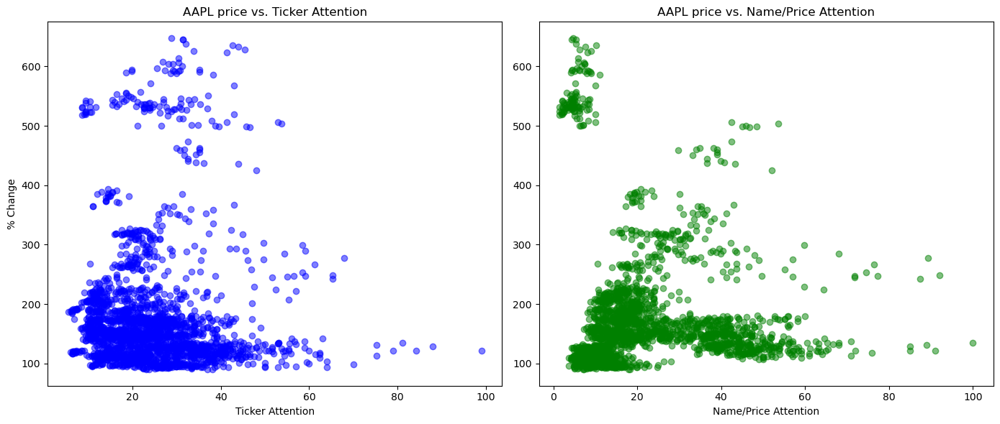

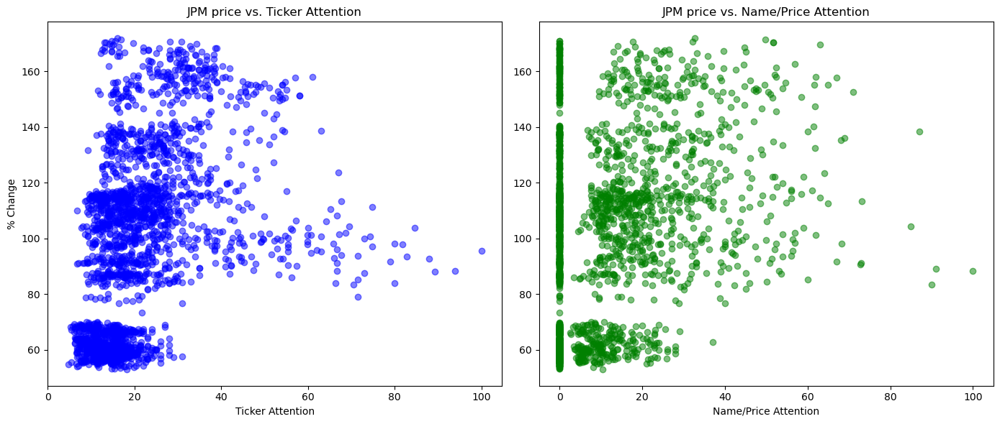

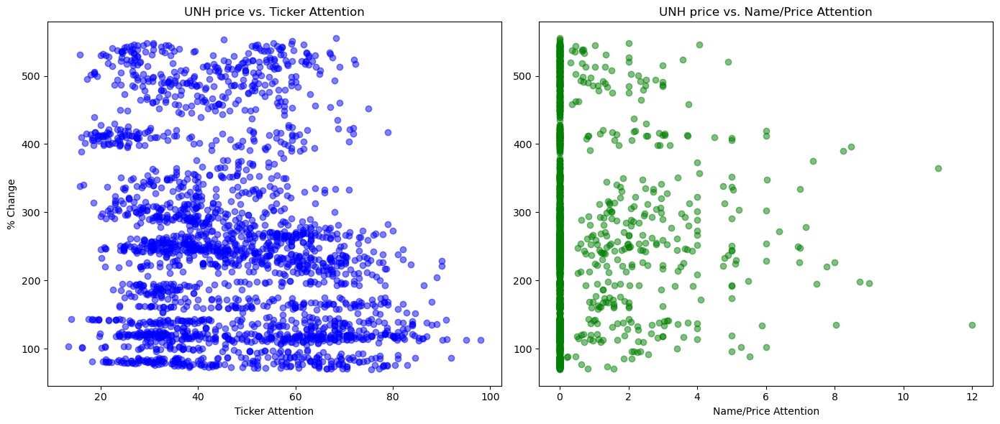

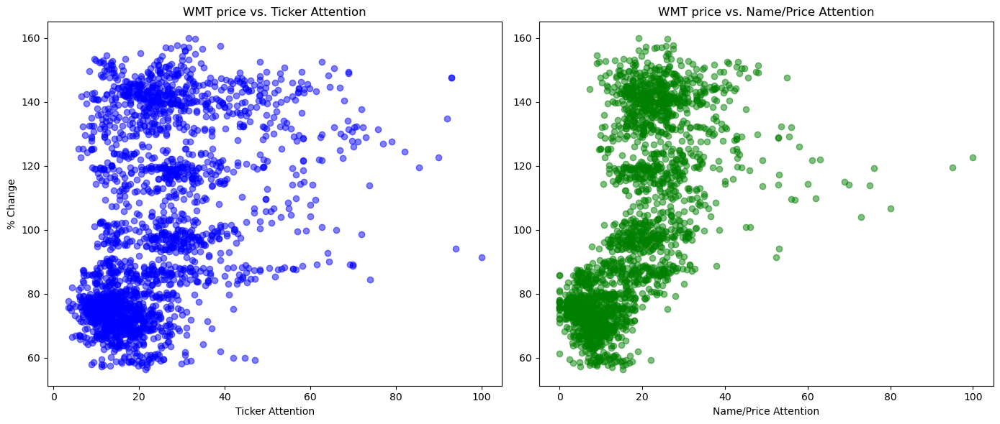

...

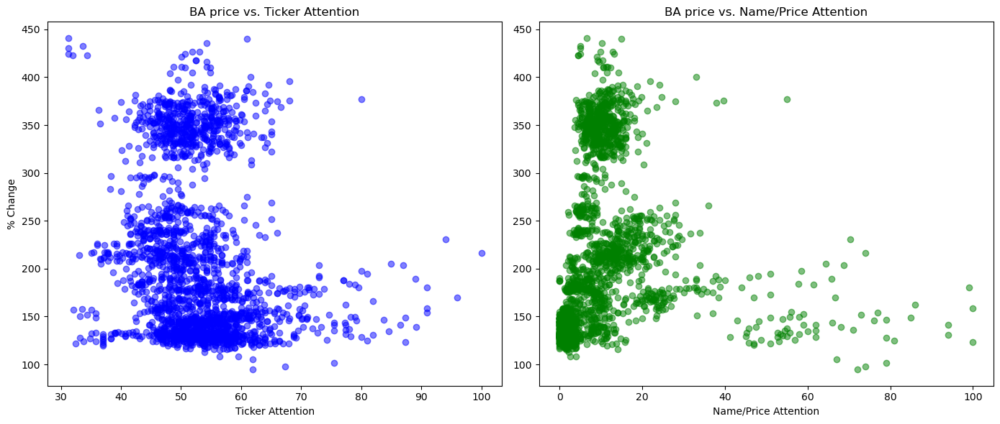

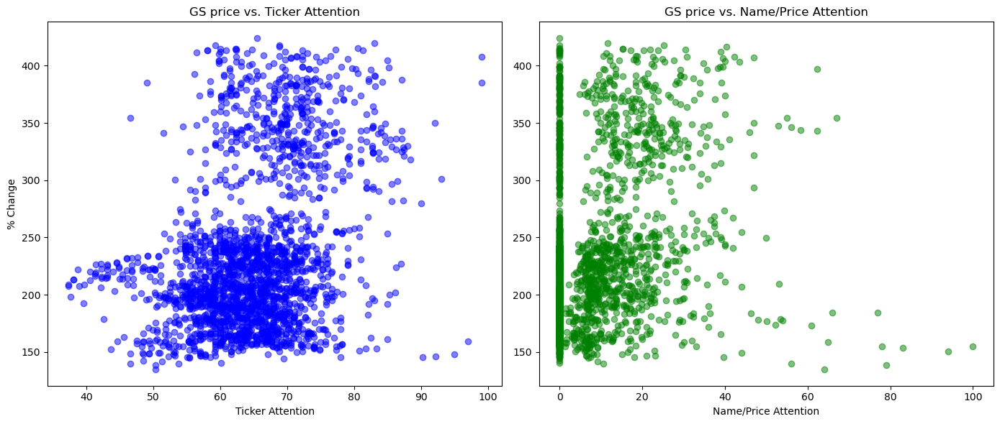

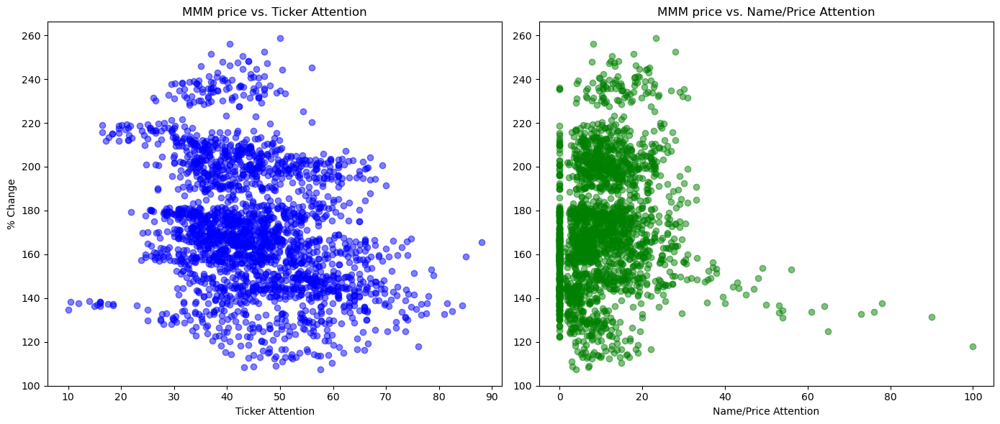

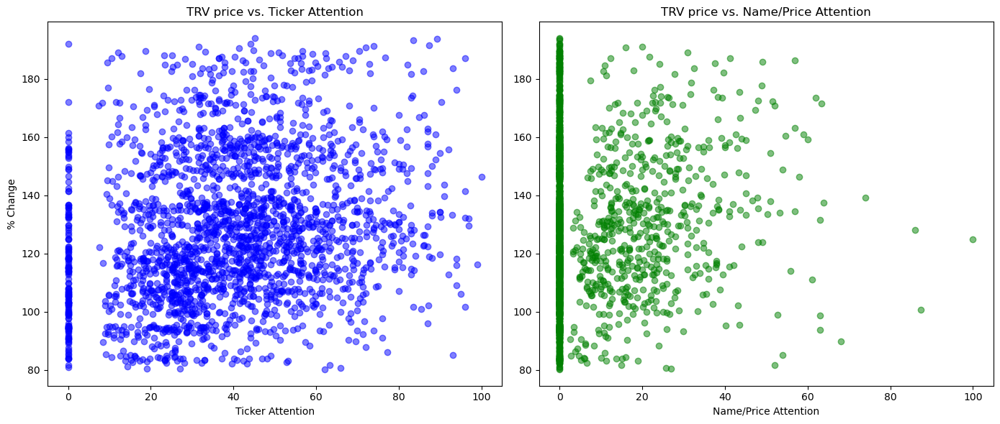

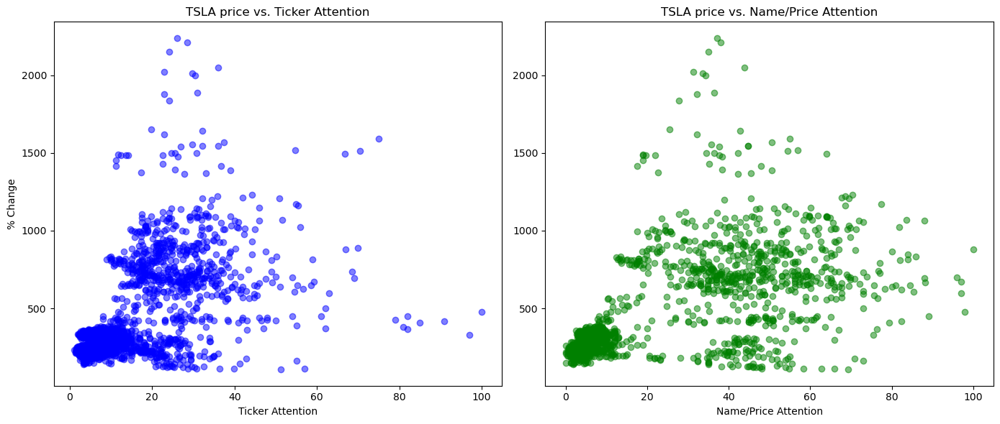

In [12]:
# write a loop that will plot the scatter plots for all stocks in the dataset

for stock in stocks:
    stock_data = data[data['ticker'] == stock]
    fig, axs = plt.subplots(1, 2, figsize=(14, 6))

    # Scatter plot for % Change vs. Ticker Attention
    axs[0].scatter(stock_data['ticker_attention'], stock_data['price'], color='blue', alpha=0.5)
    axs[0].set_title(f'{stock} price vs. Ticker Attention')
    axs[0].set_xlabel('Ticker Attention')
    axs[0].set_ylabel('% Change')

    # Scatter plot for % Change vs. Name/Price Attention
    axs[1].scatter(stock_data['name_price_attention'], stock_data['price'], color='green', alpha=0.5)
    axs[1].set_title(f'{stock} price vs. Name/Price Attention')
    axs[1].set_xlabel('Name/Price Attention')

    plt.tight_layout()
    plt.show()

# Correlation Analysis 

## Calculate Correlation Matrix

In [17]:
# write a loop to calculate the yearly correlation coefficients for all stocks in the dataset
yearly_correlation_results = []

for stock in stocks:
    stock_data = data[data['ticker'] == stock].copy()
    stock_data['date'] = pd.to_datetime(stock_data['date'])
    stock_data['Year'] = stock_data['date'].dt.year

    for year, group_data in stock_data.groupby('Year'):
        corr_matrix = group_data[['pct_return', 'ticker_attention', 'name_price_attention']].corr()
        yearly_correlation_results.append({
            'ticker': stock,
            'Year': year,
            'Corr_%Change_Ticker': corr_matrix.at['pct_return', 'ticker_attention'],
            'Corr_%Change_NamePrice': corr_matrix.at['pct_return', 'name_price_attention']
        })

# Converting the results to a DataFrame for easier viewing  
yearly_correlation_df = pd.DataFrame(yearly_correlation_results)

# Displaying the correlation results by year
yearly_correlation_df


,ticker,Year,Corr_%Change_Ticker,Corr_%Change_NamePrice
0,MSFT,2014,0.145347,0.146168
1,MSFT,2015,0.068739,0.094814
2,MSFT,2016,0.067890,-0.051132
3,MSFT,2017,0.029960,0.009885
4,MSFT,2018,0.046511,0.056220
...,...,...,...,...
275,TSLA,2019,-0.190262,-0.112509
276,TSLA,2020,-0.104413,-0.121691
277,TSLA,2021,0.051139,-0.013167
278,TSLA,2022,-0.044980,0.032102


## Visualizations of Correlation Matrix between returns and investor attention metrics

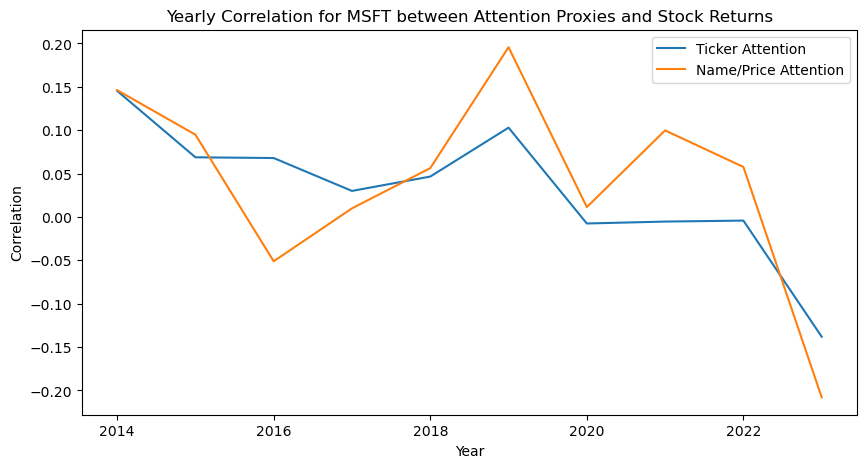

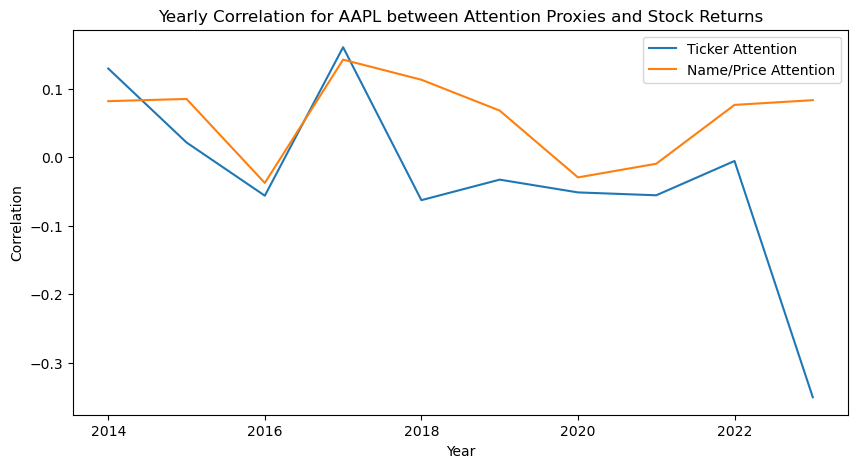

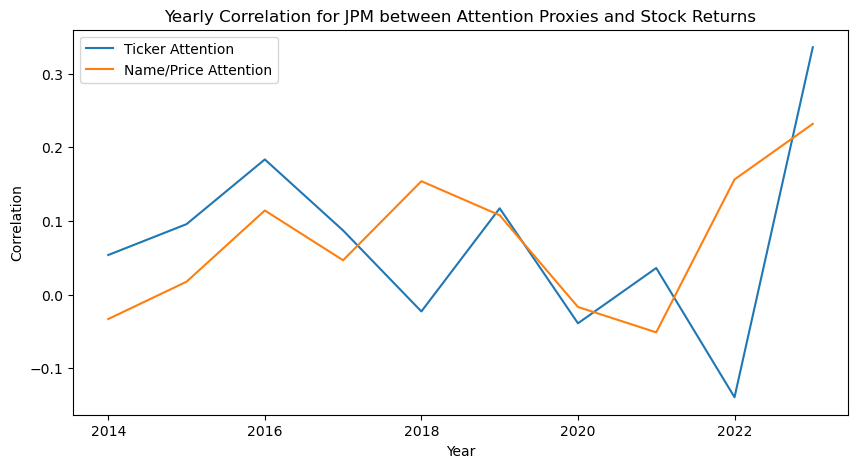

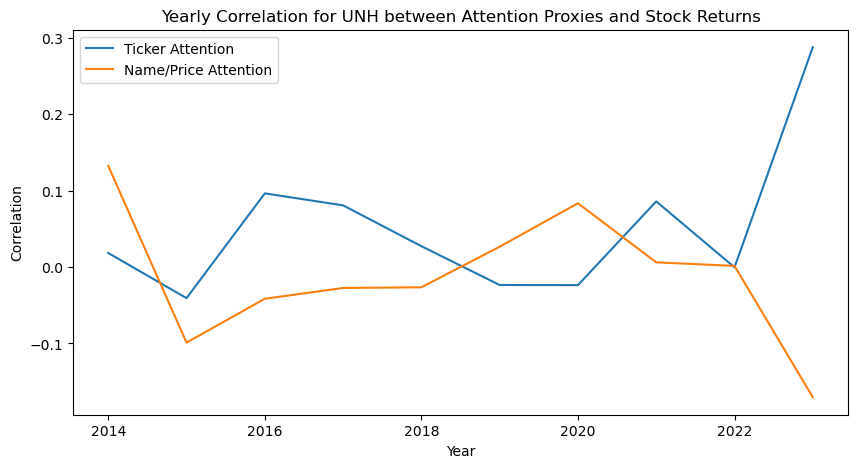

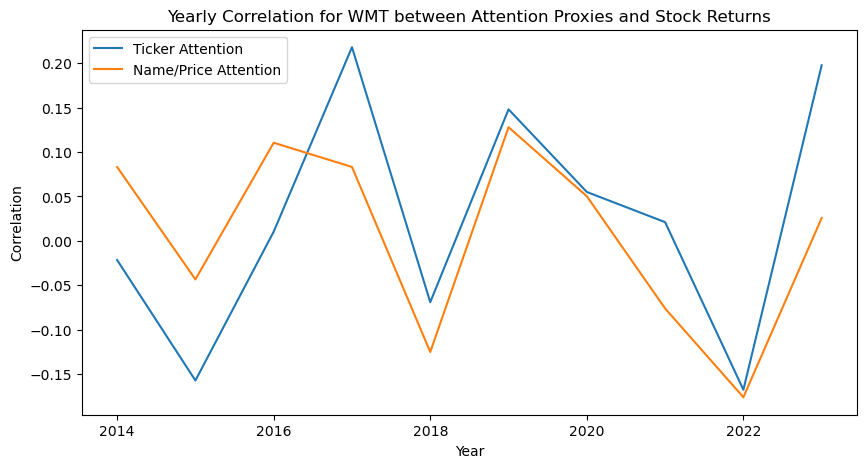

...

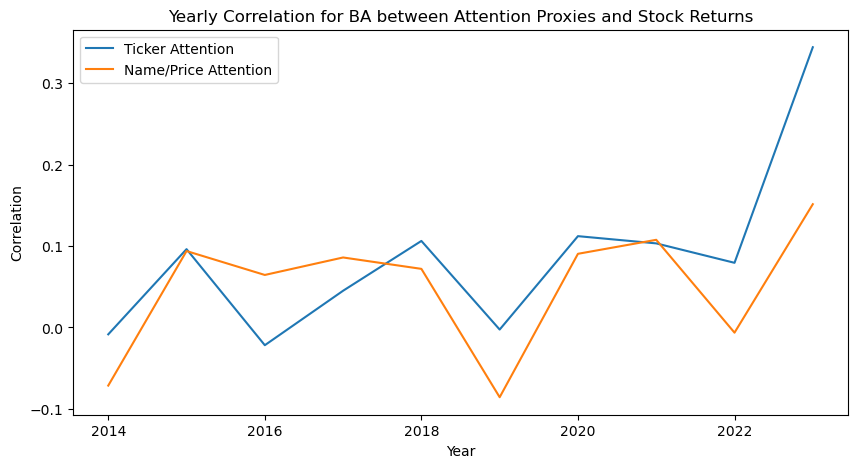

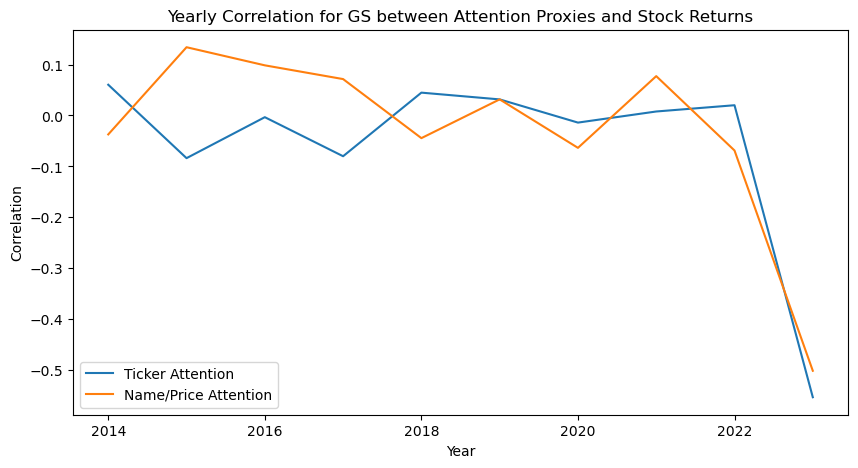

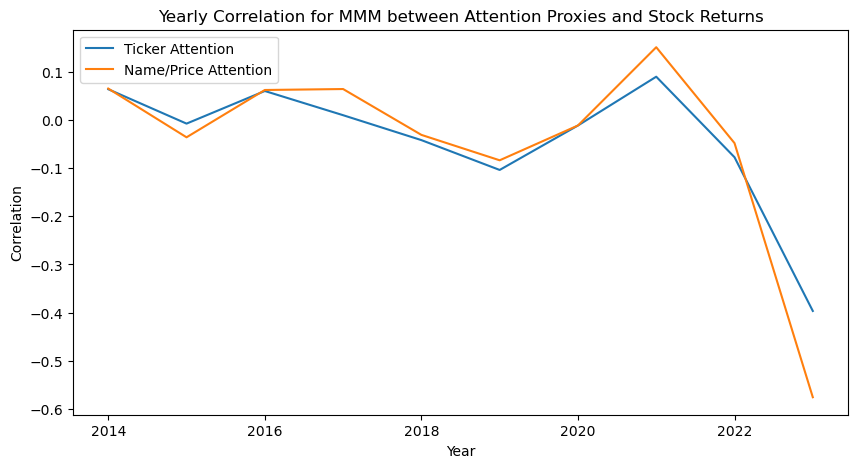

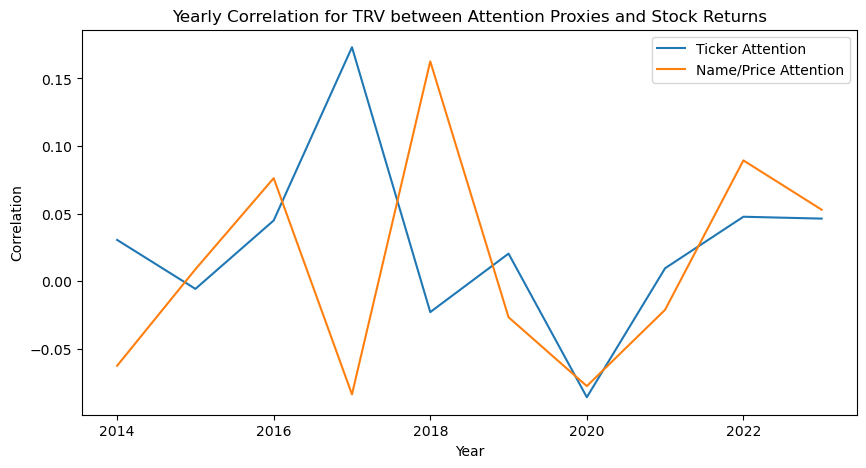

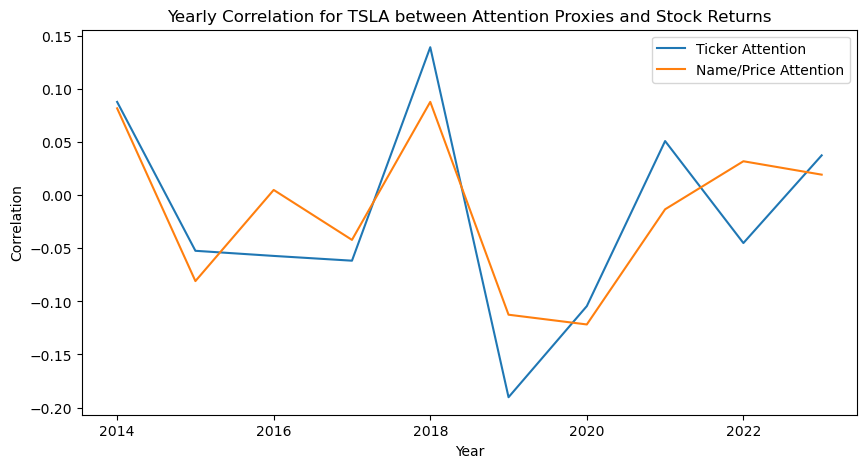

In [19]:
import matplotlib.pyplot as plt

# Get the unique stock tickers
stocks = yearly_correlation_df['ticker'].unique()

# Loop through each stock
for stock in stocks:
    # Filter the DataFrame for the current stock
    stock_df = yearly_correlation_df[yearly_correlation_df['ticker'] == stock]

    # Create a new figure
    plt.figure(figsize=(10, 5))

    # Plot the correlations
    plt.plot(stock_df['Year'], stock_df['Corr_%Change_Ticker'], label='Ticker Attention')
    plt.plot(stock_df['Year'], stock_df['Corr_%Change_NamePrice'], label='Name/Price Attention')

    # Add title and labels
    plt.title(f'Yearly Correlation for {stock} between Attention Proxies and Stock Returns')
    plt.xlabel('Year')
    plt.ylabel('Correlation')

    # Add a legend
    plt.legend()

    # Show the plot
    plt.show()

# Correlation between attention proxies

In [21]:
# write a loop to calculate the yearly correlation coefficients for all stocks in the dataset
yearly_correlation_results = []

for stock in stocks:
    stock_data = data[data['ticker'] == stock].copy()
    stock_data['date'] = pd.to_datetime(stock_data['date'])
    stock_data['Year'] = stock_data['date'].dt.year

    for year, group_data in stock_data.groupby('Year'):
        corr_matrix = group_data[['ticker_attention', 'name_price_attention']].corr()
        yearly_correlation_results.append({
            'ticker': stock,
            'Year': year,
            'Corr_Ticker_NamePrice': corr_matrix.at['ticker_attention', 'name_price_attention']
        })

# Converting the results to a DataFrame for easier viewing  
yearly_correlation_df_proxies = pd.DataFrame(yearly_correlation_results)

# Displaying the correlation results by year
yearly_correlation_df_proxies

,ticker,Year,Corr_Ticker_NamePrice
0,MSFT,2014,0.118408
1,MSFT,2015,0.256464
2,MSFT,2016,0.354089
3,MSFT,2017,0.682305
4,MSFT,2018,0.459063
...,...,...,...
275,TSLA,2019,0.801330
276,TSLA,2020,0.841662
277,TSLA,2021,0.874383
278,TSLA,2022,0.718036


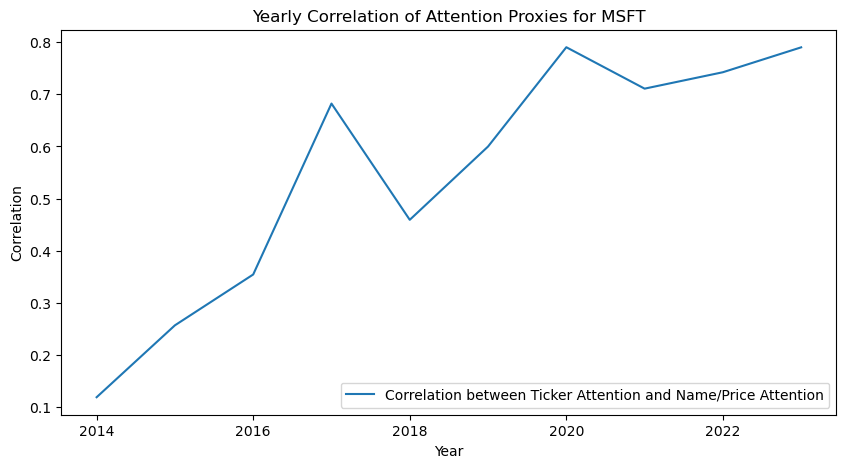

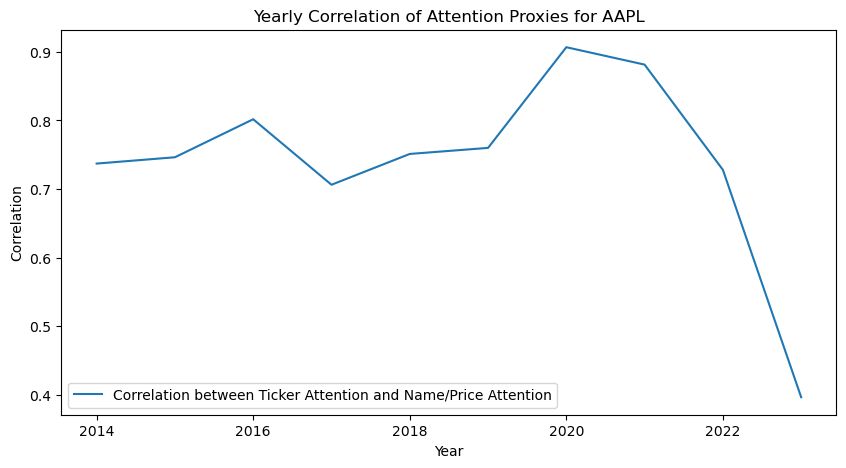

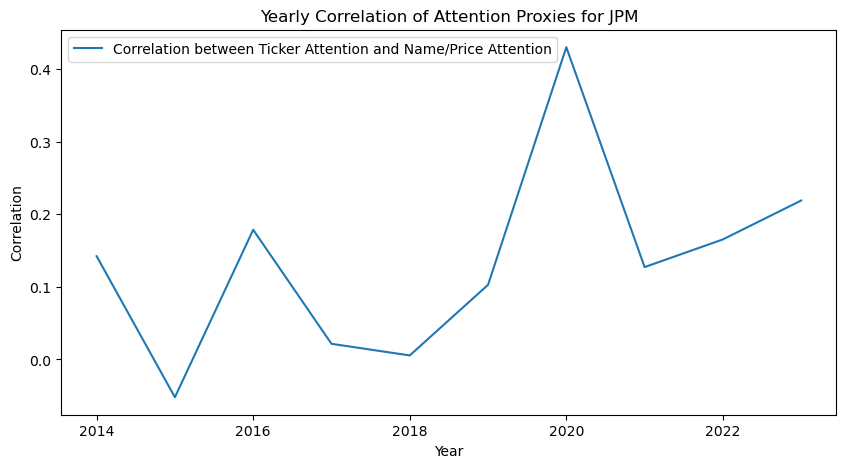

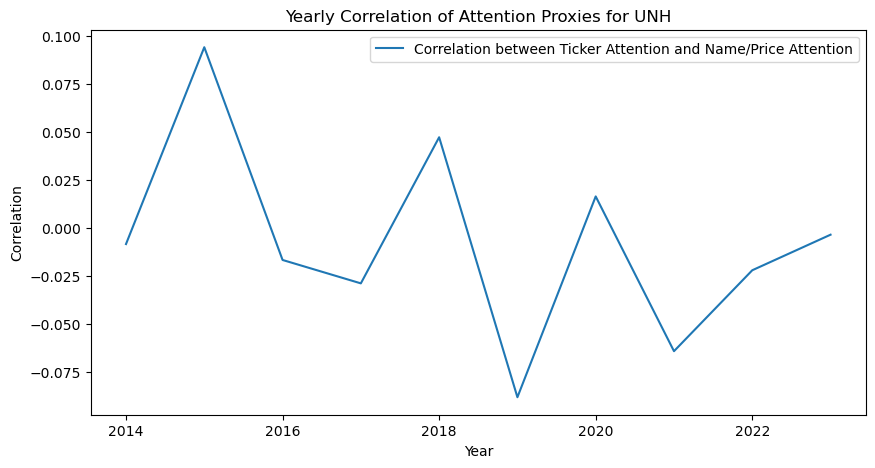

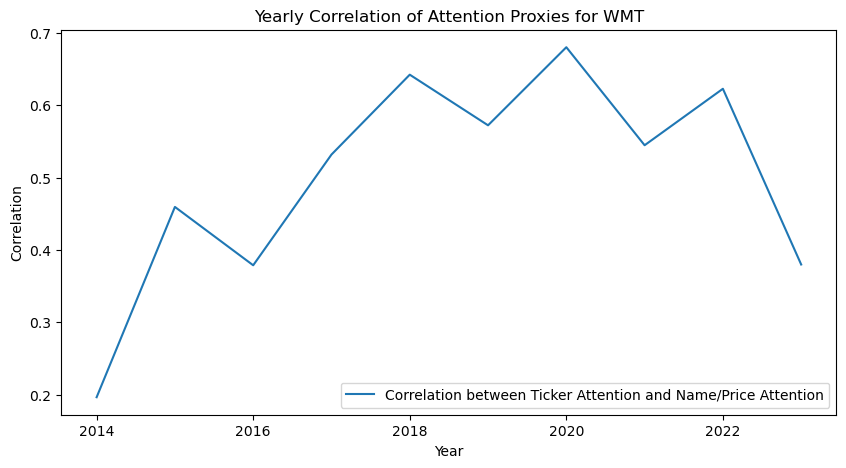

...

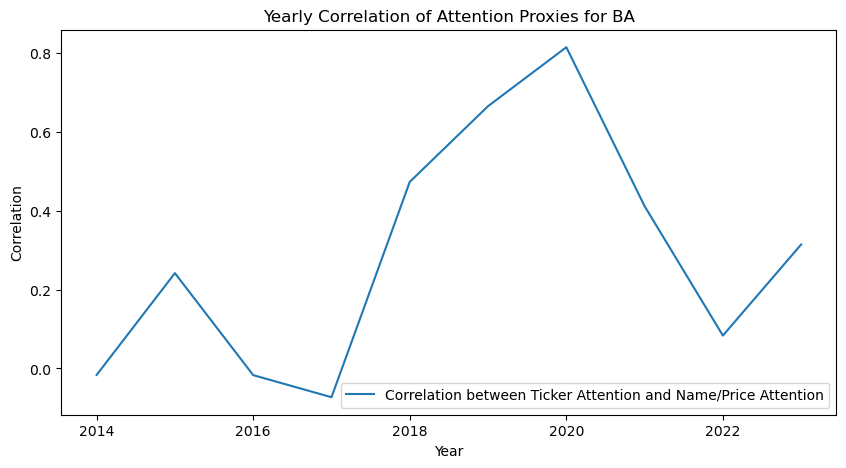

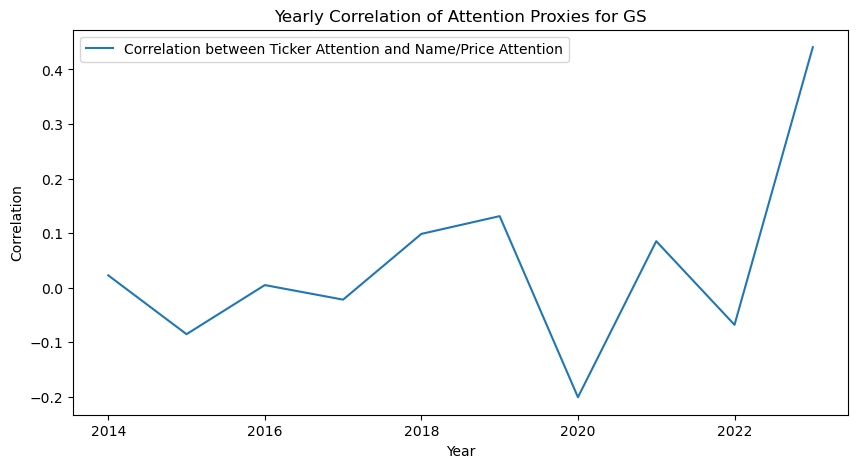

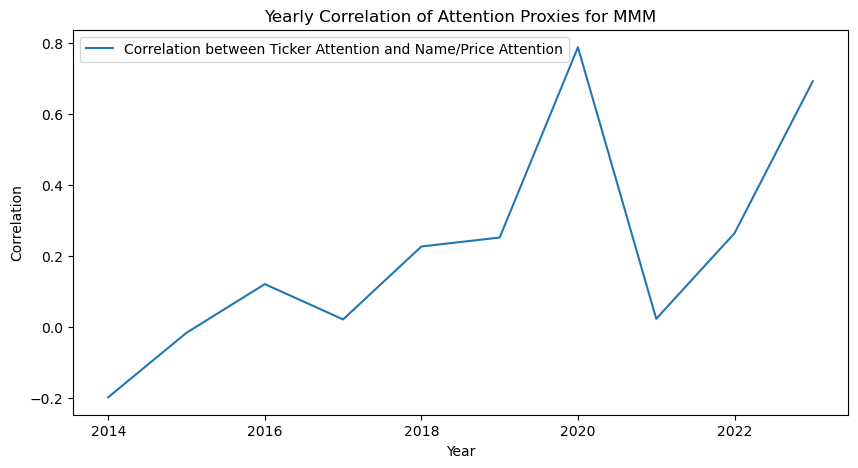

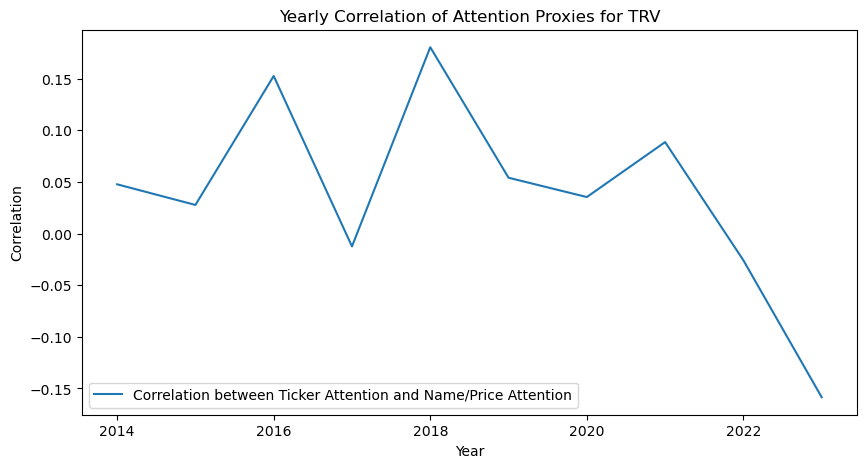

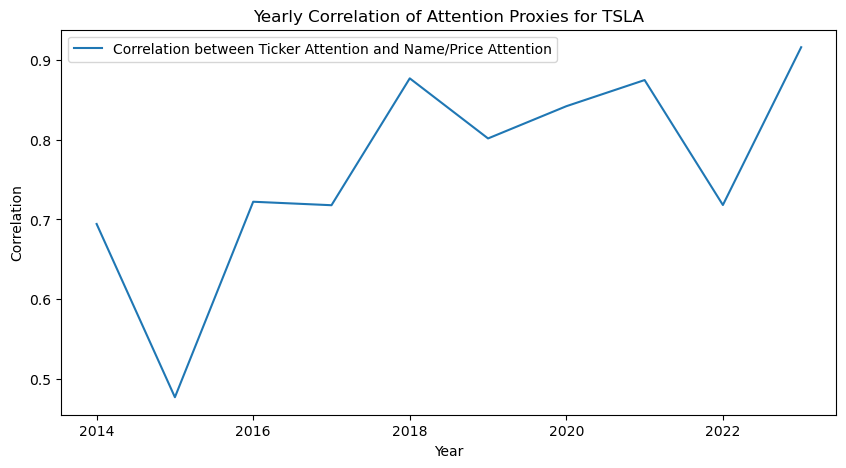

In [23]:
import matplotlib.pyplot as plt

# Get the unique stock tickers
stocks = yearly_correlation_df_proxies['ticker'].unique()

# Loop through each stock
for stock in stocks:
    # Filter the DataFrame for the current stock
    stock_df = yearly_correlation_df_proxies[yearly_correlation_df_proxies['ticker'] == stock]

    # Create a new figure
    plt.figure(figsize=(10, 5))

    # Plot the correlations
    plt.plot(stock_df['Year'], stock_df['Corr_Ticker_NamePrice'], label='Correlation between Ticker Attention and Name/Price Attention')

    # Add title and labels
    plt.title(f'Yearly Correlation of Attention Proxies for {stock}')
    plt.xlabel('Year')
    plt.ylabel('Correlation')

    # Add a legend
    plt.legend()

    # Show the plot
    plt.show()

In [20]:
# create a plot per stock to show the correlation changes over time
for stock in stocks:
    stock_data = yearly_correlation_df[yearly_correlation_df['ticker'] == stock].copy()
    stock_data['Date'] = pd.to_datetime(stock_data['Date'])
    stock_data['Year'] = stock_data['Date'].dt.year

    # Calculate yearly_correlation_df here for each stock
    yearly_correlation_df = calculate_yearly_correlation(stock_data)  # replace with your function

    fig, axs = plt.subplots(1, 2, figsize=(14, 6))

    # Scatter plot for % Change vs. Ticker Attention
    axs[0].scatter(yearly_correlation_df['Year'], yearly_correlation_df['Corr_%Change_Ticker'], color='blue', alpha=0.5)
    axs[0].set_title(f'{stock} Correlation % Change vs. Ticker Attention Over Time')
    axs[0].set_xlabel('Year')
    axs[0].set_ylabel('Correlation')

    # Scatter plot for % Change vs. Name/Price Attention
    axs[1].scatter(yearly_correlation_df['Year'], yearly_correlation_df['Corr_%Change_NamePrice'], color='green', alpha=0.5)
    axs[1].set_title(f'{stock} Correlation % Change vs. Name/Price Attention Over Time')
    axs[1].set_xlabel('Year')

    plt.tight_layout()
    plt.show()

KeyError: 'Date'

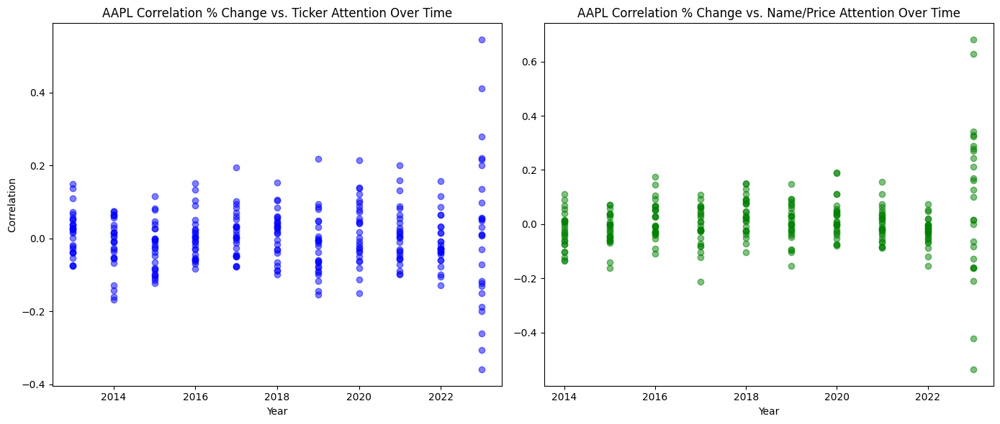

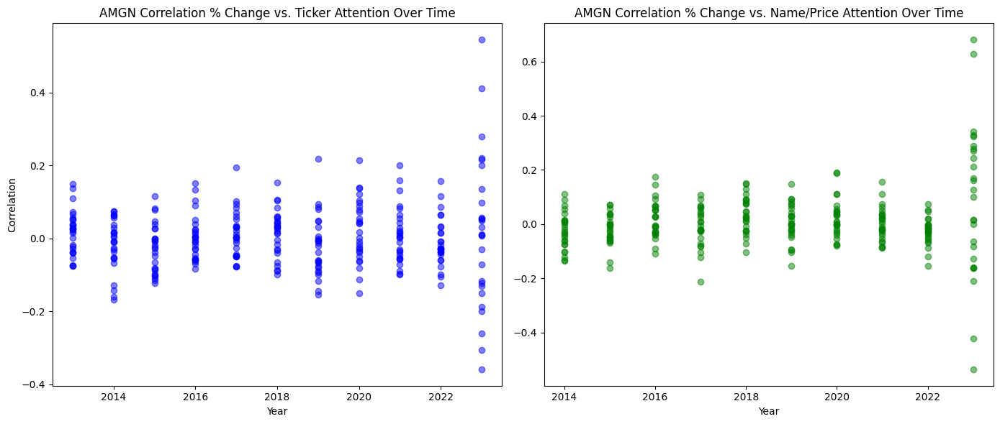

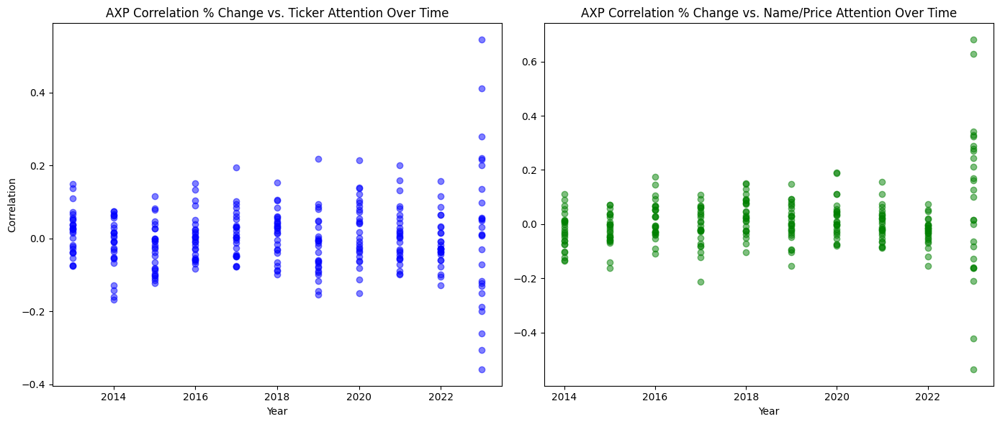

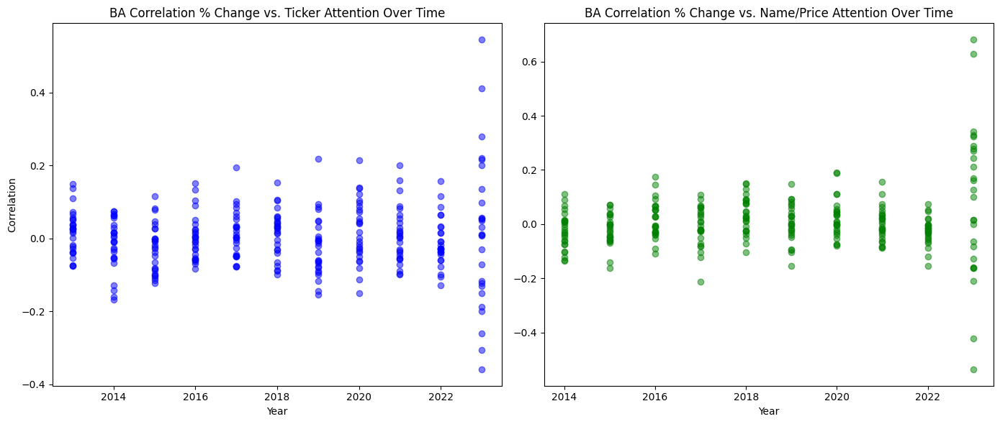

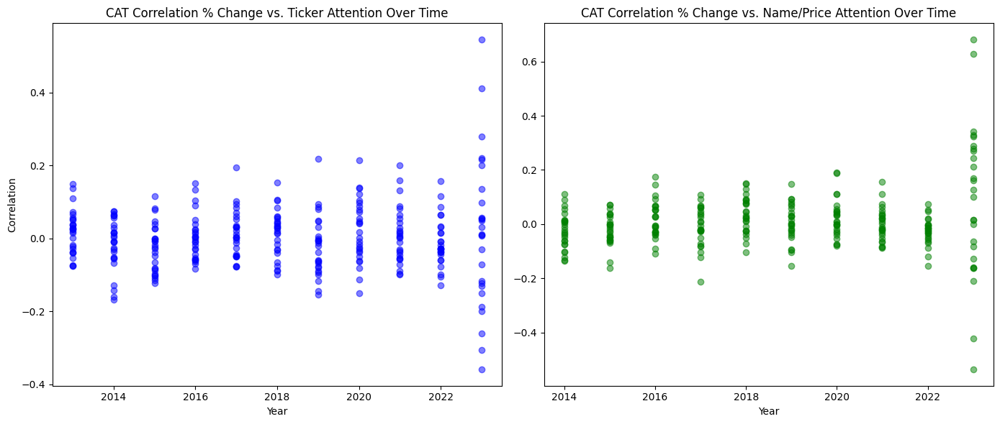

...

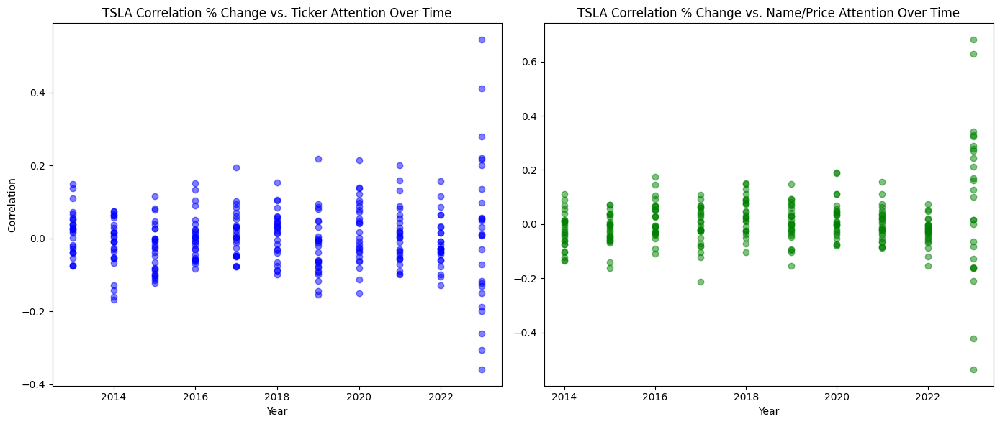

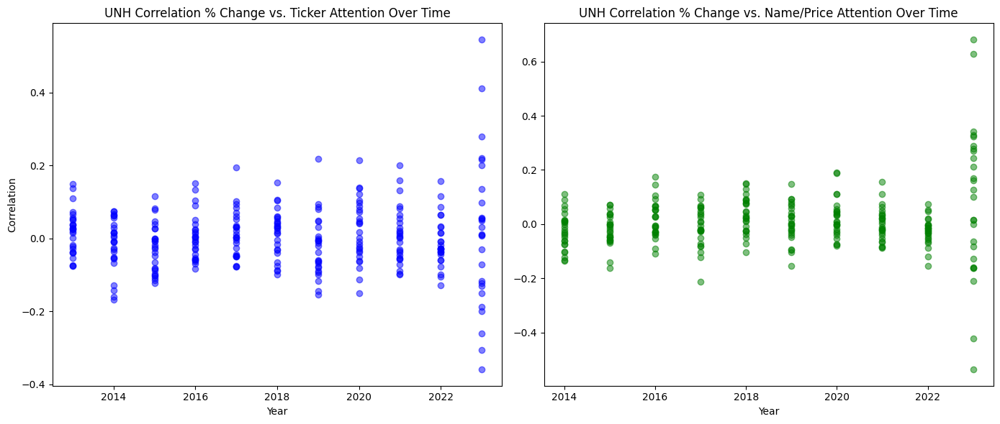

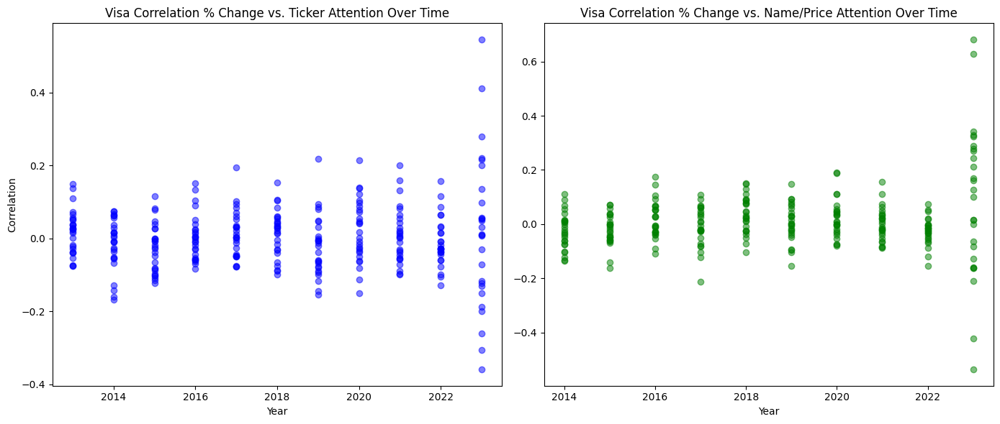

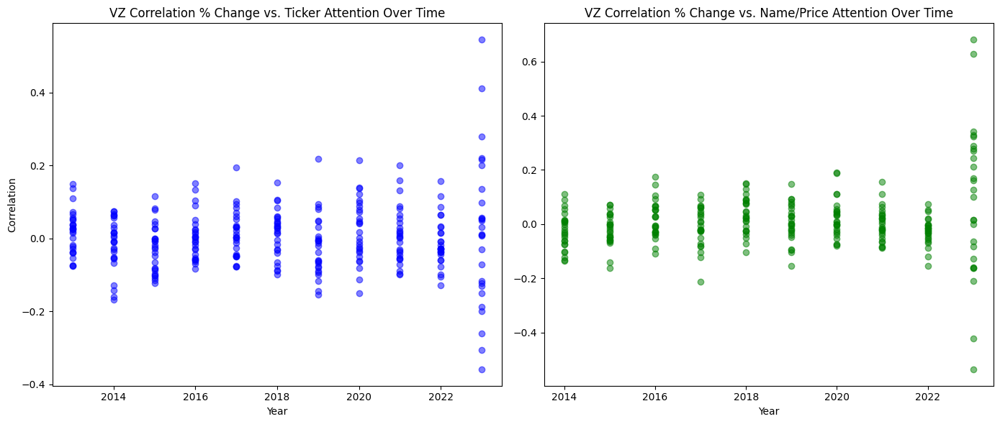

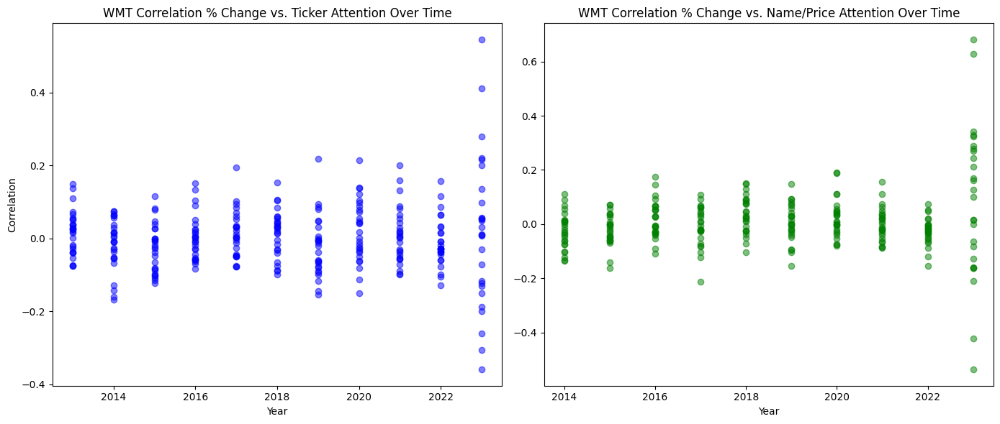

In [ ]:
# create a plot per stock to show the correlation changes over time
for stock in stocks:
    stock_data = data[data['stock'] == stock].copy()
    stock_data['Date'] = pd.to_datetime(stock_data['Date'])
    stock_data['Year'] = stock_data['Date'].dt.year

    fig, axs = plt.subplots(1, 2, figsize=(14, 6))

    # Scatter plot for % Change vs. Ticker Attention
    axs[0].scatter(yearly_correlation_df['Year'], yearly_correlation_df['Corr_%Change_Ticker'], color='blue', alpha=0.5)
    axs[0].set_title(f'{stock} Correlation % Change vs. Ticker Attention Over Time')
    axs[0].set_xlabel('Year')
    axs[0].set_ylabel('Correlation')

    # Scatter plot for % Change vs. Name/Price Attention
    axs[1].scatter(yearly_correlation_df['Year'], yearly_correlation_df['Corr_%Change_NamePrice'], color='green', alpha=0.5)
    axs[1].set_title(f'{stock} Correlation % Change vs. Name/Price Attention Over Time')
    axs[1].set_xlabel('Year')

    plt.tight_layout()
    plt.show()

In [ ]:
# Ensure 'Industry' column is available, if not recreate it based on previously defined classification
if 'Industry' not in data.columns:
    industry_classification = {
        'AAPL': 'Technology', 'AMGN': 'Healthcare', 'AXP': 'Financial Services', 'BA': 'Industrial',
        'CAT': 'Industrial', 'CRM': 'Technology', 'CSCO': 'Technology', 'CVX': 'Energy',
        'DIS': 'Entertainment', 'GS': 'Financial Services', 'HD': 'Consumer Goods', 'HON': 'Industrial',
        'IBM': 'Technology', 'INTC': 'Technology', 'JNJ': 'Healthcare', 'JPM': 'Financial Services',
        'KO': 'Consumer Goods', 'MCD': 'Consumer Goods', 'MMM': 'Industrial', 'MRK': 'Healthcare',
        'MSFT': 'Technology', 'NKE': 'Consumer Goods', 'TRV': 'Financial Services', 'TSLA': 'Technology',
        'UNH': 'Healthcare', 'VZ': 'Telecommunications', 'WMT': 'Consumer Goods', 'Visa': 'Financial Services'
    }
    data['Industry'] = data['stock'].map(industry_classification)

# Grouping the data by industry and calculating the correlation coefficients
industry_correlation_results = []

for industry, group_data in data.groupby('Industry'):
    corr_matrix = group_data[['% Change', 'ticker_attention', 'name_price_attention']].corr()
    industry_correlation_results.append({
        'Industry': industry,
        'Corr_%Change_Ticker': corr_matrix.at['% Change', 'ticker_attention'],
        'Corr_%Change_NamePrice': corr_matrix.at['% Change', 'name_price_attention']
    })

# Converting the results to a DataFrame for easier viewing
industry_correlation_df = pd.DataFrame(industry_correlation_results)

# Displaying the correlation results by industry
industry_correlation_df


,Industry,Corr_%Change_Ticker,Corr_%Change_NamePrice
0,Consumer Goods,0.007891,0.002900
1,Energy,-0.039777,-0.034253
2,Entertainment,0.027174,0.005737
3,Financial Services,-0.001099,0.006459
4,Healthcare,-0.000696,0.009173
5,Industrial,-0.007398,0.010086
6,Technology,0.034115,0.021011
7,Telecommunications,-0.017688,-0.011265


In [ ]:
# compute industry correlation over time 

industry_correlation_results = []

for industry, group_data in data.groupby('Industry'):
    group_data['Date'] = pd.to_datetime(group_data['Date'])
    group_data['Year'] = group_data['Date'].dt.year

    for year, year_group_data in group_data.groupby('Year'):
        corr_matrix = year_group_data[['% Change', 'ticker_attention', 'name_price_attention']].corr()
        industry_correlation_results.append({
            'Industry': industry,
            'Year': year,
            'Corr_%Change_Ticker': corr_matrix.at['% Change', 'ticker_attention'],
            'Corr_%Change_NamePrice': corr_matrix.at['% Change', 'name_price_attention']
        })

# Converting the results to a DataFrame for easier viewing

industry_correlation_df = pd.DataFrame(industry_correlation_results)

# Displaying the correlation results by industry and year
industry_correlation_df

,Industry,Year,Corr_%Change_Ticker,Corr_%Change_NamePrice
0,Consumer Goods,2013,0.040194,NaN
1,Consumer Goods,2014,0.012917,-0.042264
2,Consumer Goods,2015,0.001657,0.012858
3,Consumer Goods,2016,-0.001297,-0.023588
4,Consumer Goods,2017,0.019180,-0.017075
...,...,...,...,...
83,Telecommunications,2019,-0.006993,0.057116
84,Telecommunications,2020,-0.024508,-0.074034
85,Telecommunications,2021,-0.045215,-0.011106
86,Telecommunications,2022,-0.028302,-0.056768


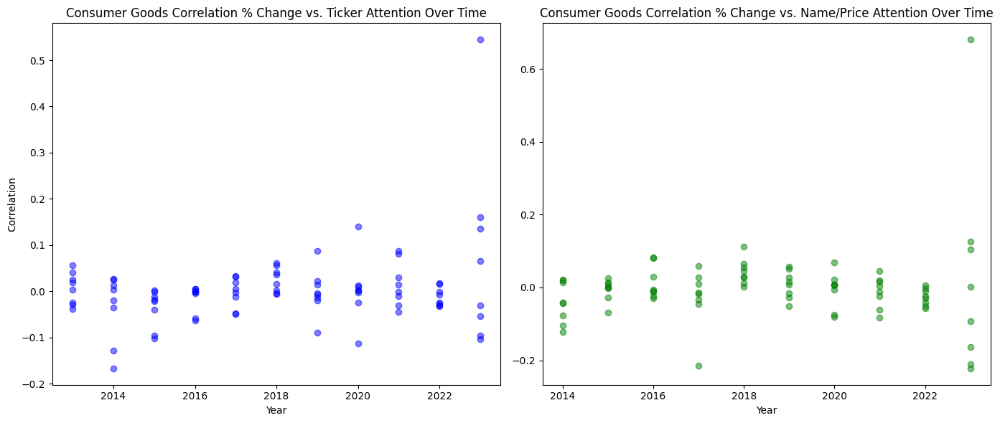

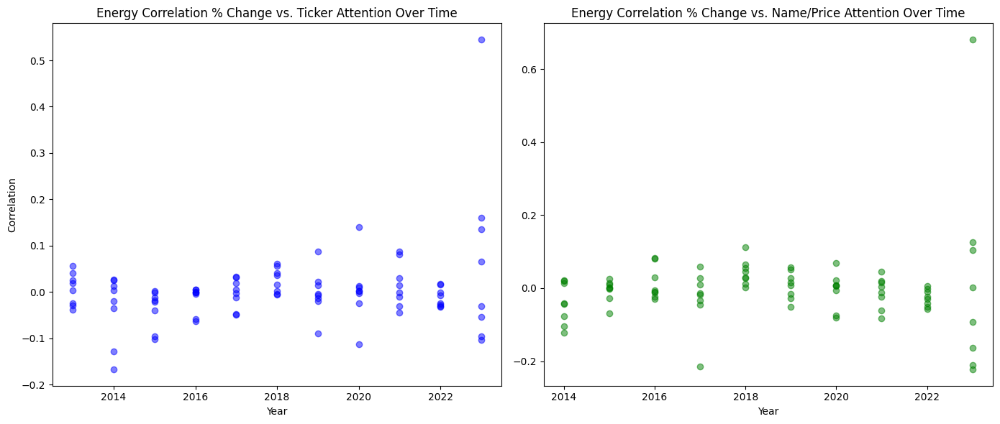

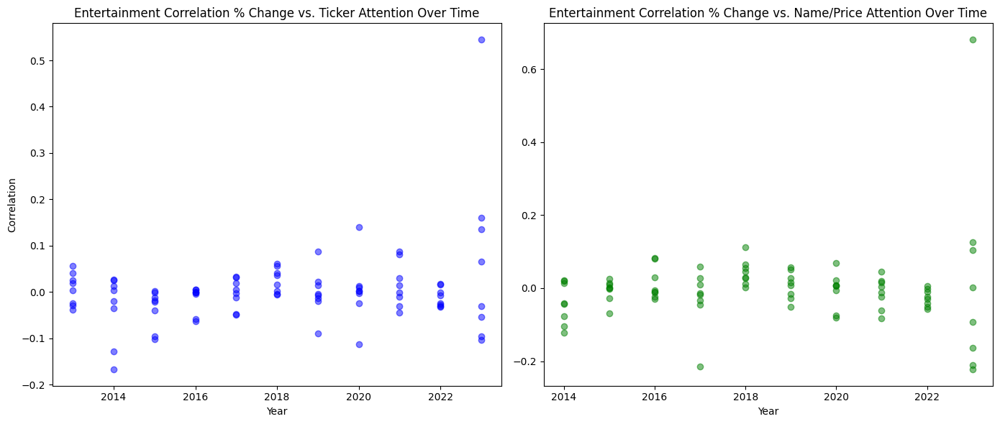

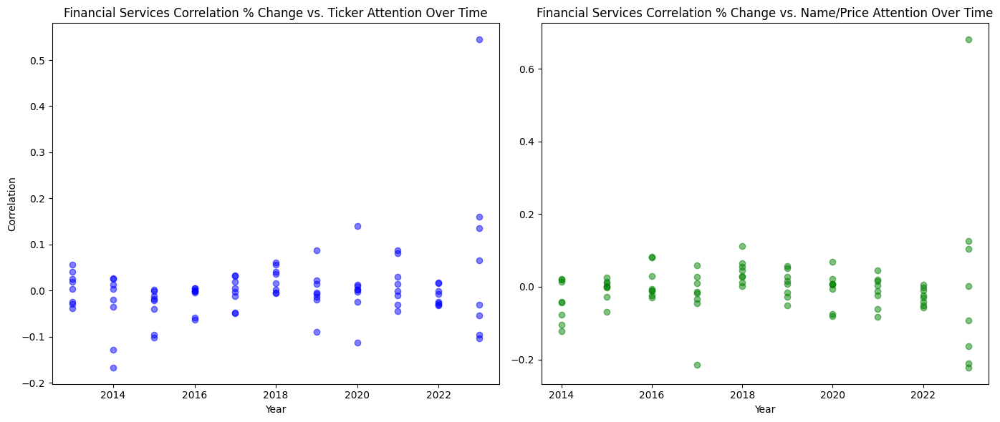

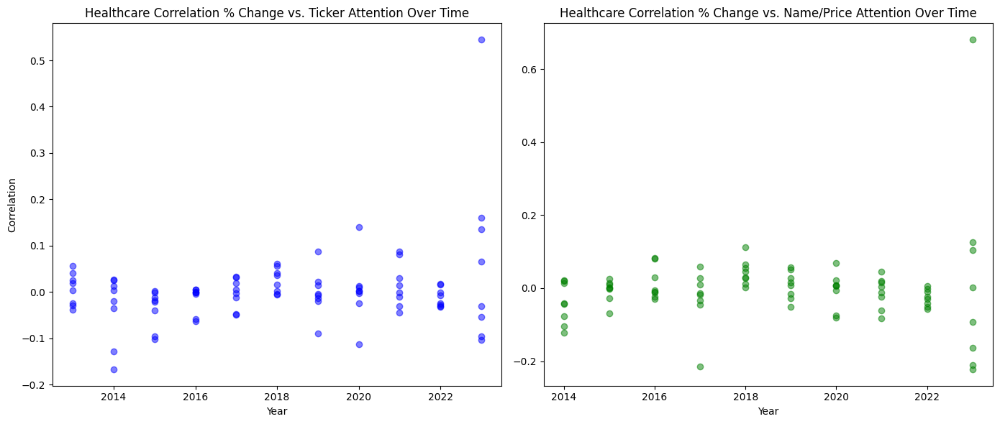

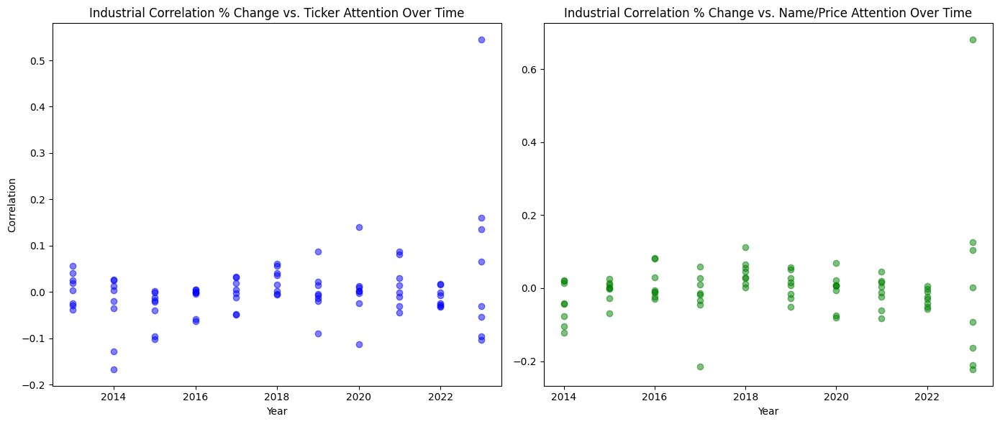

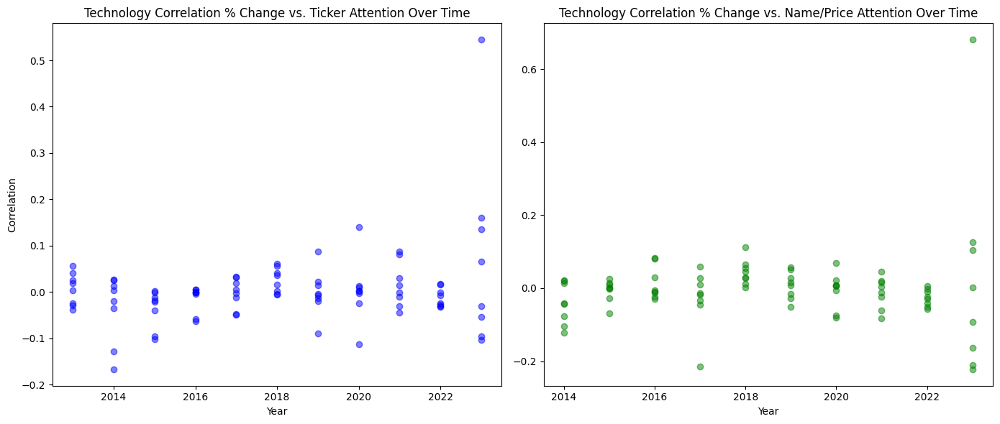

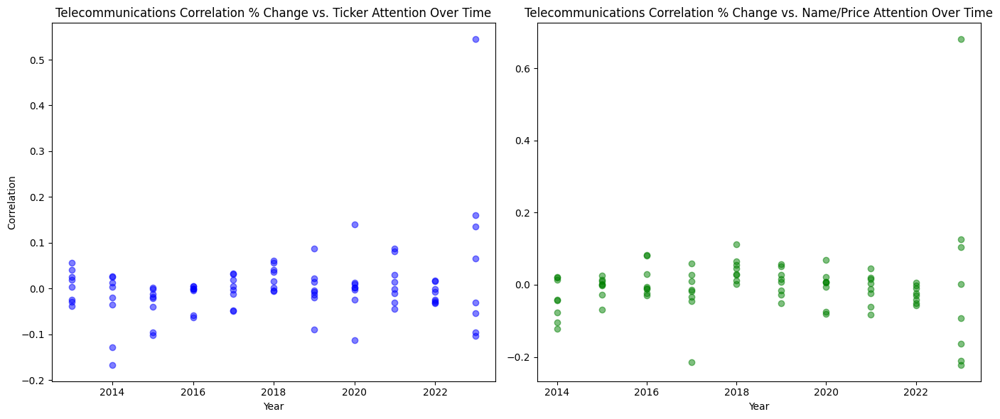

In [ ]:
# plot the industry correlation over time
for industry, group_data in data.groupby('Industry'):
    group_data['Date'] = pd.to_datetime(group_data['Date'])
    group_data['Year'] = group_data['Date'].dt.year

    fig, axs = plt.subplots(1, 2, figsize=(14, 6))

    # Scatter plot for % Change vs. Ticker Attention
    axs[0].scatter(industry_correlation_df['Year'], industry_correlation_df['Corr_%Change_Ticker'], color='blue', alpha=0.5)
    axs[0].set_title(f'{industry} Correlation % Change vs. Ticker Attention Over Time')
    axs[0].set_xlabel('Year')
    axs[0].set_ylabel('Correlation')

    # Scatter plot for % Change vs. Name/Price Attention
    axs[1].scatter(industry_correlation_df['Year'], industry_correlation_df['Corr_%Change_NamePrice'], color='green', alpha=0.5)
    axs[1].set_title(f'{industry} Correlation % Change vs. Name/Price Attention Over Time')
    axs[1].set_xlabel('Year')

    plt.tight_layout()
    plt.show()

In [ ]:
pip install statsmodels

  Obtaining dependency information for statsmodels from https://files.pythonhosted.org/packages/2e/e7/636f44ea2e42327feaf7e82d9943a17010b6bd1d2aee1691a82f6f8df26d/statsmodels-0.14.1-cp312-cp312-macosx_10_9_x86_64.whl.metadata
  Obtaining dependency information for scipy!=1.9.2,>=1.4 from https://files.pythonhosted.org/packages/0d/4a/b2b2cae0c5dfd46361245a67102886ed7188805bdf7044e36fe838bbcf26/scipy-1.12.0-cp312-cp312-macosx_10_9_x86_64.whl.metadata
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.4/60.4 kB 1.3 MB/s eta 0:00:00a 0:00:01
  Obtaining dependency information for patsy>=0.5.4 from https://files.pythonhosted.org/packages/43/f3/1d311a09c34f14f5973bb0bb0dc3a6e007e1eda90b5492d082689936ca51/patsy-0.5.6-py2.py3-none-any.whl.metadata
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.4/10.4 MB 651.4 kB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.9/233.9 kB 2.4 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 38.9/38.9 MB 672.7 kB/s eta 0

In [ ]:
import statsmodels.api as sm


In [ ]:
model = sm.GLM(data['PX_LAST'], sm.add_constant(data['ticker_attention']))
result1 = model.fit()
print(result1.summary())

                 Generalized Linear Model Regression Results                  
Dep. Variable:                PX_LAST   No. Observations:                68776
Model:                            GLM   Df Residuals:                    68774
Model Family:                Gaussian   Df Model:                            1
Link Function:               Identity   Scale:                          5313.8
Method:                          IRLS   Log-Likelihood:            -3.9257e+05
Date:                Tue, 27 Feb 2024   Deviance:                   3.6545e+08
Time:                        15:44:18   Pearson chi2:                 3.65e+08
No. Iterations:                     3   Pseudo R-squ. (CS):            0.08349
Covariance Type:            nonrobust                                         
                       coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------
const               69.4469      0.557  

In [ ]:
data.head()

,stock,Date,PX_LAST,PX_OPEN,PX_HIGH,PX_LOW,PX_VOLUME,Volatility,Change,% Change,ticker_attention,name_price_attention,Industry,ticker_attention_%_change,name_price_attention_%_change,transformed_price,transformed_ticker_attention
0,AAPL,2023-01-31,143.305,141.726,143.355,141.309,NaN,2.046,-1.132,-0.783733,18.20,51.52,Technology,NaN,NaN,4.964975,2.901422
1,AAPL,2023-01-30,142.024,143.966,144.557,141.875,NaN,2.682,-1.281,-0.893898,18.48,44.24,Technology,0.015385,-0.141304,4.955996,2.916689
2,AAPL,2023-01-27,144.934,142.178,146.225,142.103,NaN,4.122,2.910,2.048949,18.76,54.88,Technology,0.015152,0.240506,4.976278,2.931727
3,AAPL,2023-01-26,142.977,142.193,143.265,140.931,NaN,2.334,-1.957,-1.350270,20.72,49.84,Technology,0.104478,-0.091837,4.962684,3.031099
4,AAPL,2023-01-25,140.892,139.928,141.458,137.863,NaN,3.595,-2.085,-1.458277,17.92,47.04,Technology,-0.135135,-0.056180,4.947994,2.885917


In [ ]:
#rough

import scipy

def calculate_dist_correlation(data):
    dist = scipy.spatial.distance.correlation(data['ticker_attention'], data['PX_LAST'])
    #correlation_coefficient, p_value = scipy.stats.pearsonr(data[x], data[y])
    return dist

calculate_dist_correlation(data)

0.7168220710158527

In [ ]:
pearson_corr = data[['ticker_attention', 'PX_LAST']].corr(method='pearson')
pearson_corr

,ticker_attention,PX_LAST
ticker_attention,1.000000,0.283178
PX_LAST,0.283178,1.000000


In [ ]:
distance_corr = scipy.spatial.distance.correlation(data['ticker_attention'], data['PX_LAST'])

distance_corr

0.7168220710158527

In [ ]:
# do distance correlatiom for all stocks yearly
yearly_distance_correlation_results = []

for stock in stocks:
    stock_data = data[data['stock'] == stock].copy()
    stock_data['Date'] = pd.to_datetime(stock_data['Date'])
    stock_data['Year'] = stock_data['Date'].dt.year

    for year, group_data in stock_data.groupby('Year'):
        dist = scipy.spatial.distance.correlation(group_data['ticker_attention'], group_data['PX_LAST'])
        yearly_distance_correlation_results.append({
            'Stock': stock,
            'Year': year,
            'Distance_Correlation': dist
        })

# Converting the results to a DataFrame for easier viewing
yearly_distance_correlation_df = pd.DataFrame(yearly_distance_correlation_results)

# Displaying the correlation results by year
yearly_distance_correlation_df

,Stock,Year,Distance_Correlation
0,AAPL,2013,1.069077
1,AAPL,2014,0.556743
2,AAPL,2015,0.711631
3,AAPL,2016,1.431862
4,AAPL,2017,0.805636
...,...,...,...
293,WMT,2019,0.961360
294,WMT,2020,0.715644
295,WMT,2021,1.515412
296,WMT,2022,1.015522


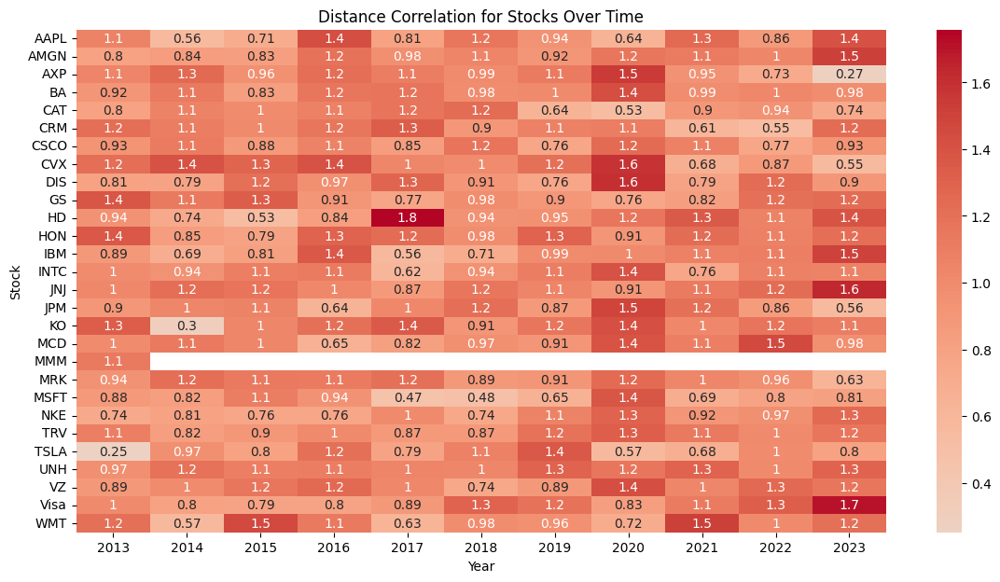

In [ ]:
#plot a heatmap of the distance correlation for all stocks
# Create a pivot table with the data
distance_correlation_pivot = yearly_distance_correlation_df.pivot(index='Stock', columns='Year', values='Distance_Correlation')

# Create the heatmap
plt.figure(figsize=(14, 7))
sns.heatmap(distance_correlation_pivot, annot=True, cmap='coolwarm', center=0)
plt.title('Distance Correlation for Stocks Over Time')
plt.show()

